# Exploring Dataset and Visualisation

### Exploring Data Set

In [2]:
#Import libraries
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as dt
sns.set_style('darkgrid')
from sklearn.preprocessing import LabelEncoder
import warnings
warnings.filterwarnings('ignore')
import os
import plotly.graph_objs as go
import joblib
import itertools
from sklearn.metrics import roc_auc_score, roc_curve, explained_variance_score
from sklearn.model_selection import cross_val_score
from statsmodels.tsa.seasonal import seasonal_decompose as season
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics import accuracy_score, balanced_accuracy_score
from sklearn.model_selection import train_test_split, RandomizedSearchCV, GridSearchCV, StratifiedKFold
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.metrics import confusion_matrix, accuracy_score, recall_score, precision_score
from sklearn.metrics import classification_report, f1_score
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import learning_curve
from mlxtend.plotting import plot_decision_regions
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.pipeline import make_pipeline
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor
from xgboost import XGBRFRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from sklearn.neural_network import MLPRegressor
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from statsmodels.tsa.stattools import adfuller, acf, pacf
from statsmodels.tsa.arima_model import ARIMA
from pmdarima.utils import decomposed_plot
from pmdarima.arima import decompose
from pmdarima import auto_arima
from sklearn.linear_model import LassoCV
from sklearn.linear_model import RidgeCV
from sklearn.mixture import GaussianMixture
import missingno as msno

In [3]:
#Read file
df = pd.read_csv('VOO-1.csv')
print(list(df.columns))

['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume']


In [4]:
df.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,2010-09-09,102.500000,102.500000,101.139999,101.320000,78.213036,26500
1,2010-09-10,101.680000,101.860001,101.300003,101.779999,78.568130,8600
2,2010-09-13,102.959999,103.139999,102.500000,103.059998,79.556221,33750
3,2010-09-14,102.839996,103.480003,102.379997,103.040001,79.540771,59400
4,2010-09-15,102.620003,103.379997,102.400002,103.300003,79.741447,9250


### Checking and Plotting Null Values

Date         0
Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64
Total number of null values:  0


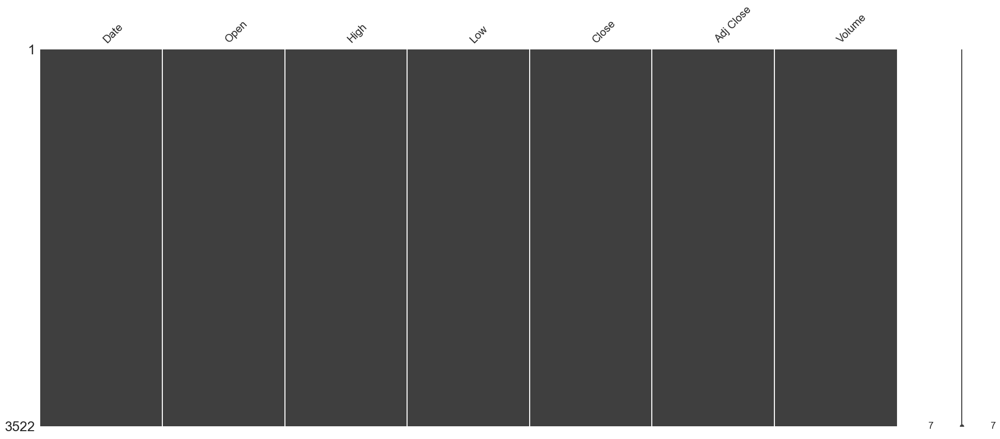

In [5]:
#Check null values
print(df.isnull().sum())
print('Total number of null values: ', df.isnull().sum().sum())

#Plot null values
# Matrix Plot
msno.matrix(df)
plt.show()

### Checking Correlation Coeficients

In [6]:
# #Prints coeficients correlation of every column with Adj Close column
df_nodate = df.drop(columns=['Date'])
all_corr = df_nodate.corr().abs()['Adj Close'].sort_values(ascending=False)
print(all_corr.to_string())

Adj Close    1.000000
Close        0.999361
High         0.999319
Low          0.999191
Open         0.999160
Volume       0.632507


### Checking Pair Correlation

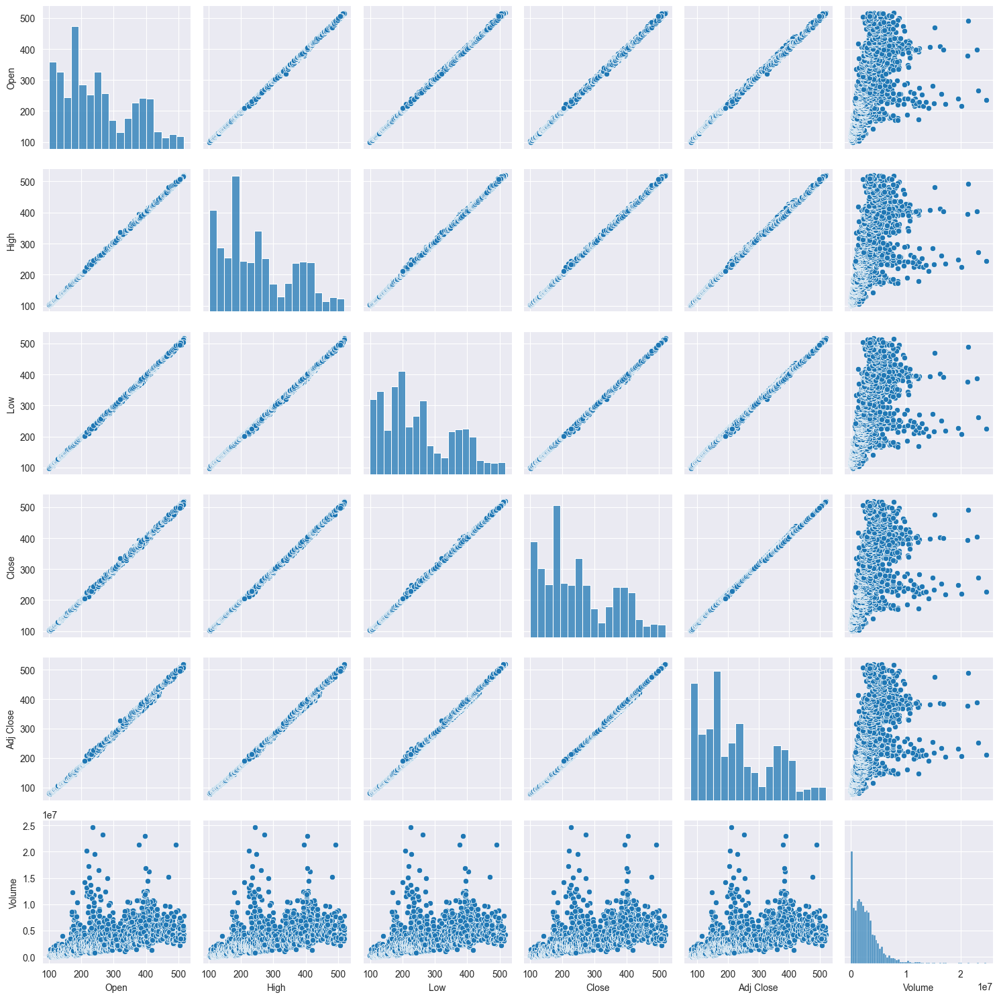

In [7]:
#Plots pair correlation of all features
sns.pairplot(df_nodate)
plt.tight_layout()

### Extracting Date-Related Features

In [8]:
df['Date'] = pd.to_datetime(df['Date'])
df['Day'] = df['Date'].dt.weekday
df['Month'] = df['Date'].dt.month
df['Year'] = df['Date'].dt.year
df['Week'] = df['Date'].dt.isocalendar().week
df['Quarter'] = df['Date'].dt.quarter

#Sets Date column as index
df = df.set_index('Date')
df.sort_index(ascending=True, inplace=True)
df.head(10)


,Open,High,Low,Close,Adj Close,Volume,Day,Month,Year,Week,Quarter
Date,,,,,,,,,,,
2010-09-09,102.500000,102.500000,101.139999,101.320000,78.213036,26500,3,9,2010,36,3
2010-09-10,101.680000,101.860001,101.300003,101.779999,78.568130,8600,4,9,2010,36,3
2010-09-13,102.959999,103.139999,102.500000,103.059998,79.556221,33750,0,9,2010,37,3
2010-09-14,102.839996,103.480003,102.379997,103.040001,79.540771,59400,1,9,2010,37,3
2010-09-15,102.620003,103.379997,102.400002,103.300003,79.741447,9250,2,9,2010,37,3
2010-09-16,103.019997,103.320000,102.699997,103.260002,79.710632,59550,3,9,2010,37,3
2010-09-17,103.879997,103.879997,103.019997,103.360001,79.787796,49350,4,9,2010,37,3
2010-09-20,103.739998,105.040001,103.459999,105.040001,81.084641,19000,0,9,2010,38,3
2010-09-21,105.019997,105.440002,104.279999,104.720001,80.837631,19250,1,9,2010,38,3


### Checking Dataset Information

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3522 entries, 2010-09-09 to 2024-09-06
Data columns (total 11 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       3522 non-null   float64
 1   High       3522 non-null   float64
 2   Low        3522 non-null   float64
 3   Close      3522 non-null   float64
 4   Adj Close  3522 non-null   float64
 5   Volume     3522 non-null   int64  
 6   Day        3522 non-null   int32  
 7   Month      3522 non-null   int32  
 8   Year       3522 non-null   int32  
 9   Week       3522 non-null   UInt32 
 10  Quarter    3522 non-null   int32  
dtypes: UInt32(1), float64(5), int32(4), int64(1)
memory usage: 264.8 KB


### Plotting Correlation

<Axes: >

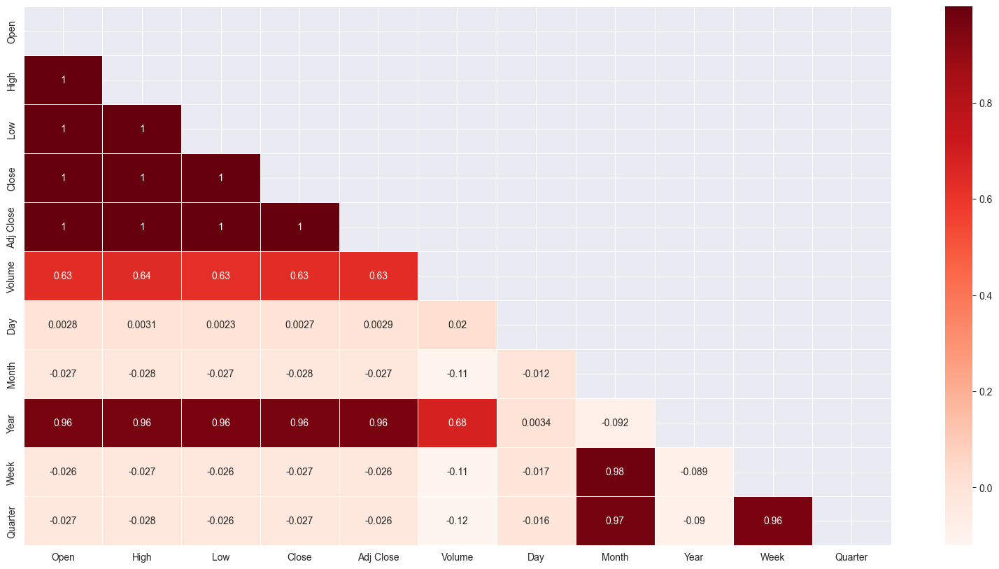

In [10]:
#Plots the correlation between each feature by using heatmap
fig, ax = plt.subplots(figsize=(20, 10))
mask = np.triu(np.ones_like(df.corr(), dtype=np.bool_))
sns.heatmap(df.corr(), annot=True, cmap='Reds', mask=mask, linewidths=0.5)

### Converting into Meaningful String

In [11]:
# Creates a dummy dataframe for visualisation
df_dummy = df.copy()

#Converts days and months from numerics to meaningful string 
days = {0:'Monday', 1:'Tuesday', 2:'Wednesday', 3:'Thursday', 4:'Friday'}
df_dummy['Day'] = df_dummy['Day'].map(days)
months = {1:'January', 2:'February', 3:'March', 4:'April', 5:'May', 6:'June', 7:'July', 8:'August', 9:'September', 10:'October', 11:'November', 12:'December'}
df_dummy['Month'] = df_dummy['Month'].map(months)
quarters = {1:'Jan-March', 2:'April-June', 3:'July-Sept', 4:'Oct-Dec'}
df_dummy['Quarter'] = df_dummy['Quarter'].map(quarters)

### Distribution of Year

In [12]:
#Define function to create pie chart and bar plot as subplots
def plot_pie_bar_chart(df,var, title=''):
    plt.figure(figsize=(25,10))
    plt.subplot(121)
    label_list = list(df[var].value_counts().index)

    df[var].value_counts().plot.pie(autopct = '%1.1f%%', colors = sns.color_palette('prism',7), startangle = 60, labels=label_list, wedgeprops={'linewidth':2, 'edgecolor':'k'}, shadow=True, textprops={'fontsize':20})
    plt.title("Distribution of "+ var + " variable " + title, fontsize=25)

    value_counts = df[var].value_counts()
    print("Count values:")
    print(value_counts)
    plt.subplot(122)
    ax = df[var].value_counts().plot(kind='barh')

    for i,j in enumerate(df[var].value_counts().values):
        ax.text(.7,i,j,weight = 'bold', fontsize=20)

    plt.title("Count of "+ var +" cases "+ title, fontsize=25)
    plt.show()

Count values:
Year
2020    253
2011    252
2013    252
2014    252
2015    252
2016    252
2019    252
2021    252
2017    251
2018    251
2022    251
2012    250
2023    250
2024    172
2010     80
Name: count, dtype: int64


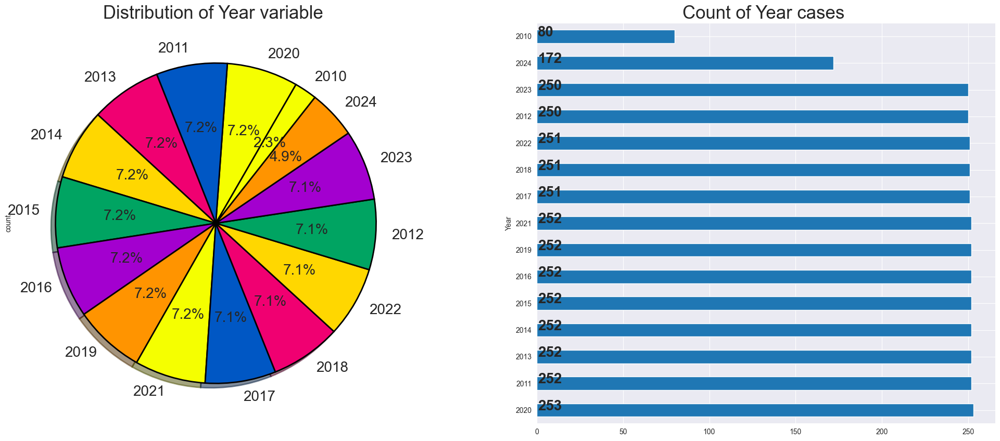

In [13]:
#Plots case distribution of Year
plot_pie_bar_chart(df_dummy, "Year")

### Distribution of Day

Count values:
Day
Tuesday      723
Wednesday    722
Thursday     712
Friday       708
Monday       657
Name: count, dtype: int64


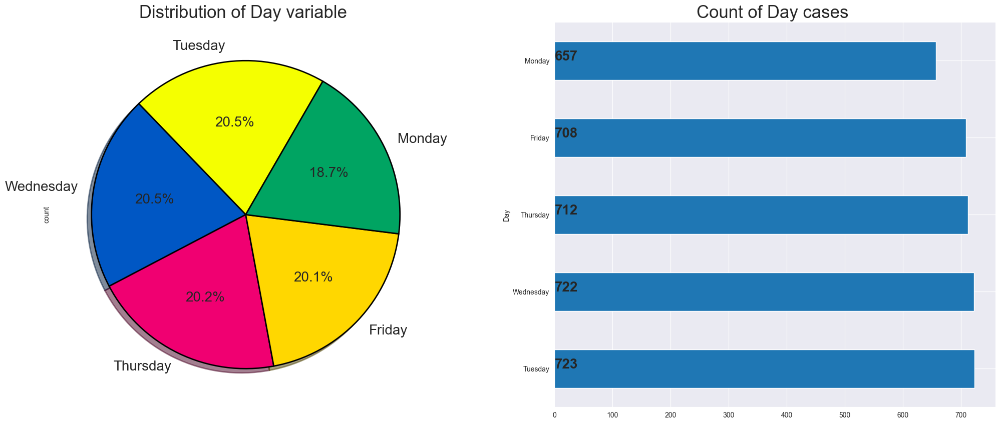

In [14]:
#Plots case distribution of Day 
plot_pie_bar_chart(df_dummy, "Day")

### Distribution of Month

Count values:
Month
August       312
October      306
March        306
May          298
June         296
July         295
December     294
April        289
November     288
September    285
January      284
February     269
Name: count, dtype: int64


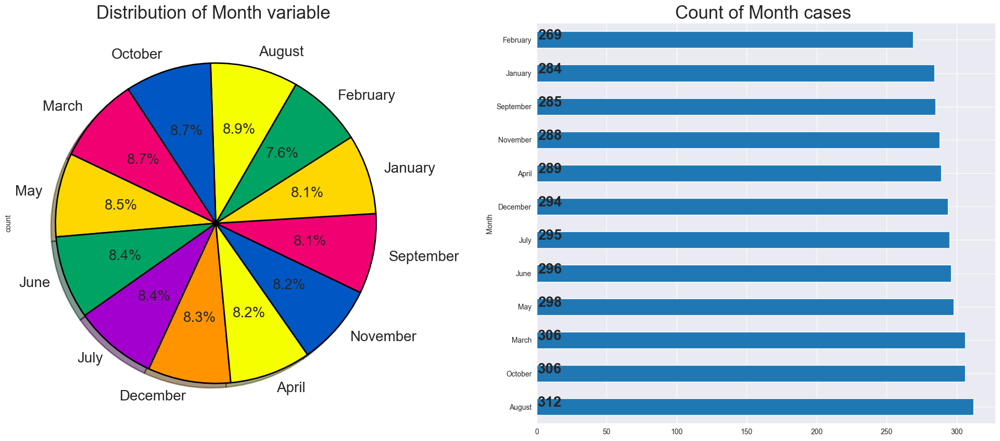

In [15]:
#Plots case distribution of Month
plot_pie_bar_chart(df_dummy, "Month")

### Distribution of Quarter

Count values:
Quarter
July-Sept     892
Oct-Dec       888
April-June    883
Jan-March     859
Name: count, dtype: int64


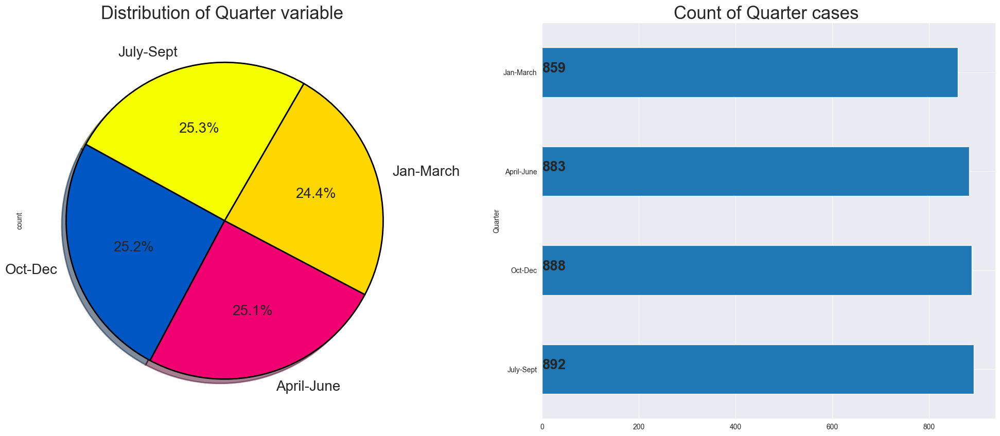

In [16]:
#Plots case distribution of Quarter
plot_pie_bar_chart(df_dummy, "Quarter")

### Scatter distribution of Open versus ADJ Close versus Year

<Axes: xlabel='Open', ylabel='Adj Close'>

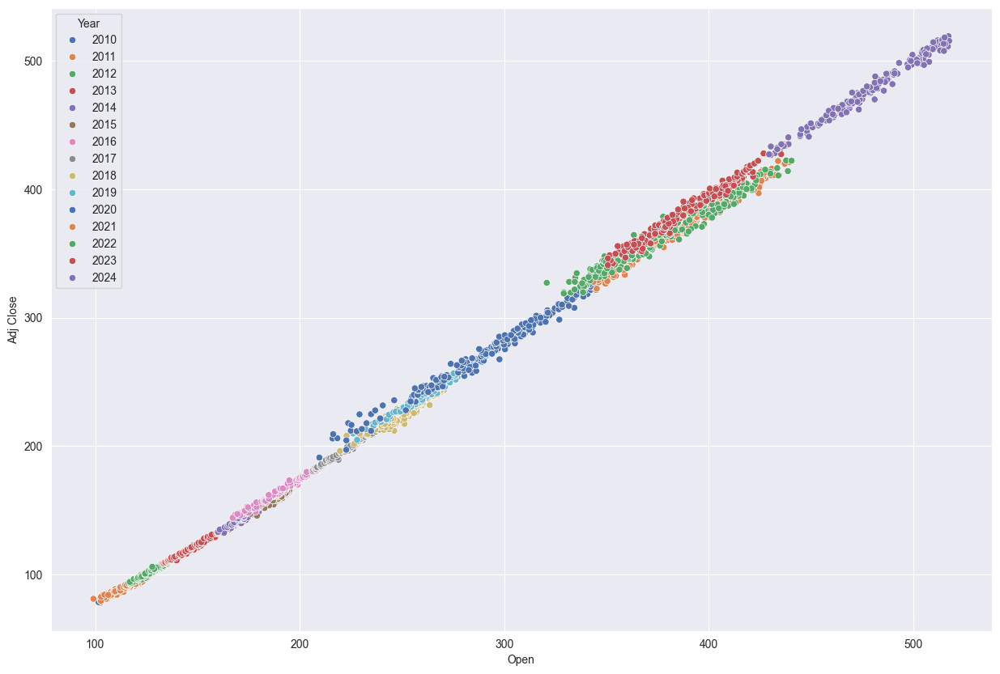

In [17]:
#Plots the scatter distribution of Open vs Adj Close vs Year
fig, ax1 = plt.subplots(figsize=(15,10))
sns.scatterplot(data=df_dummy, x='Open', y='Adj Close', hue='Year', palette='deep', ax=ax1)

### Scatter distribution of Low versus High versus Quarter

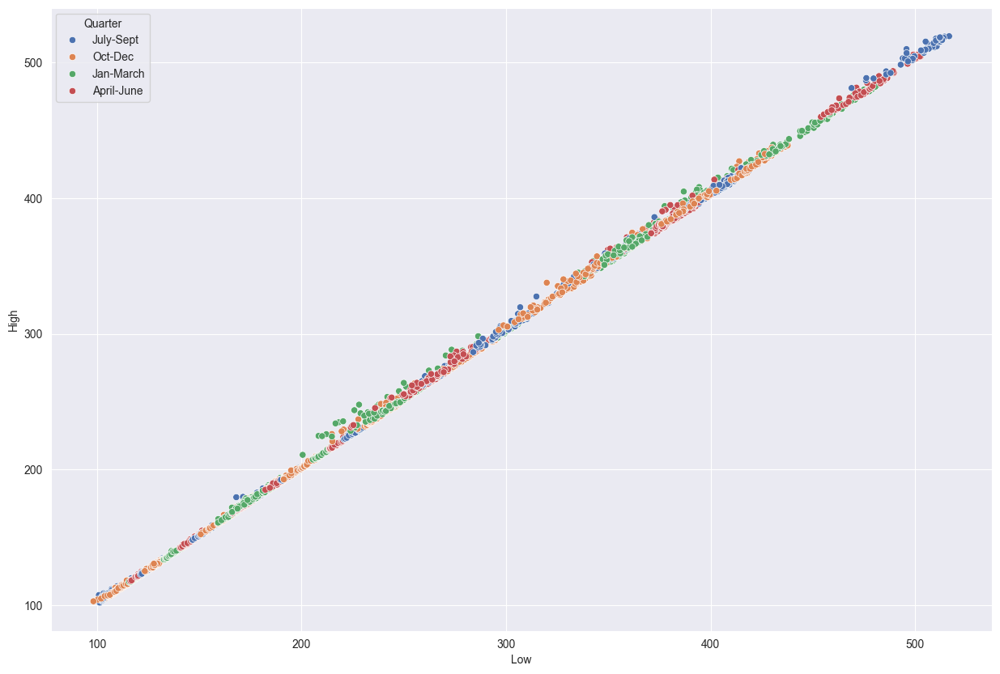

In [18]:
#Plots the scatter distribution of Low vs High vs Quarter
fig, ax1 = plt.subplots(figsize=(15,10))
scatter_plot = sns.scatterplot(data=df_dummy, x="Low", y="High", hue="Quarter", palette="deep", ax=ax1)

#Access the data points
scatter_data = scatter_plot.collections[0].get_offsets()
x_values = scatter_data[:, 0]
y_values = scatter_data[:, 1]
hue_values = df_dummy["Quarter"].values

#Create a DataFrame with the values
data = {"Low values": x_values, "High values": y_values, "Quarter values": hue_values}
df_values = pd.DataFrame(data)

#Save the DataFrame to a tabular format in a text file
df_values.to_csv("low_vs_high_vs_quarter.txt", sep="\t", index=False)

### Scatter distribution of Adj Close versus Volume versus Month

<Axes: xlabel='Adj Close', ylabel='Volume'>

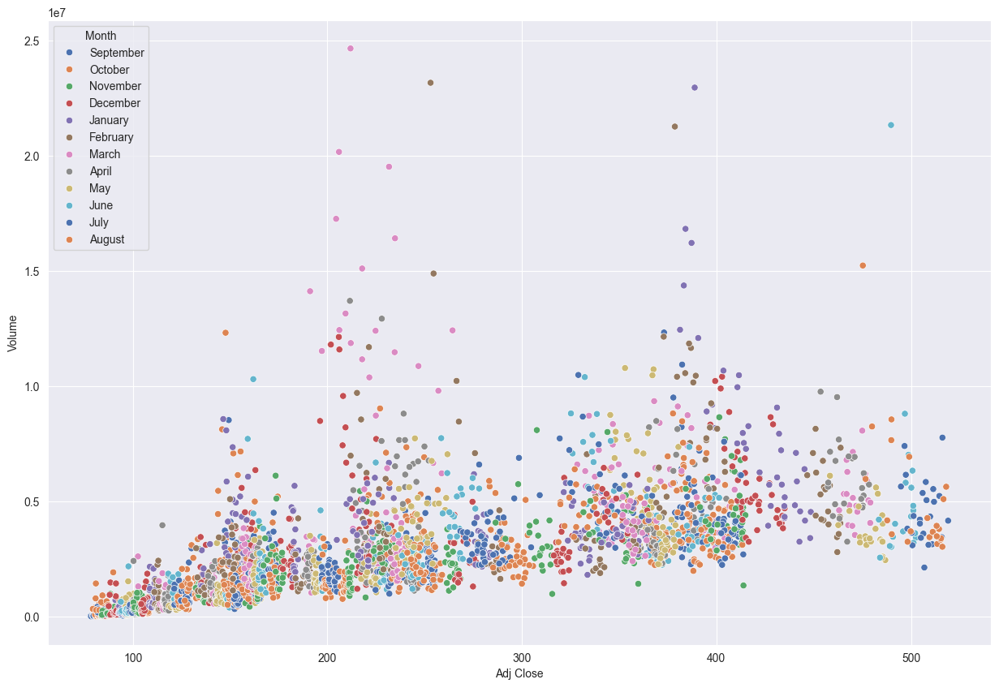

In [19]:
#Plots the scatter distribution of Adj Close vs Volume vs Month
fig, ax1 = plt.subplots(figsize=(15,10))
sns.scatterplot(data=df_dummy, x="Adj Close", y="Volume", hue="Month", palette="deep", ax=ax1)

### Scatter distribution of High vs Volume vs Day

<Axes: xlabel='High', ylabel='Volume'>

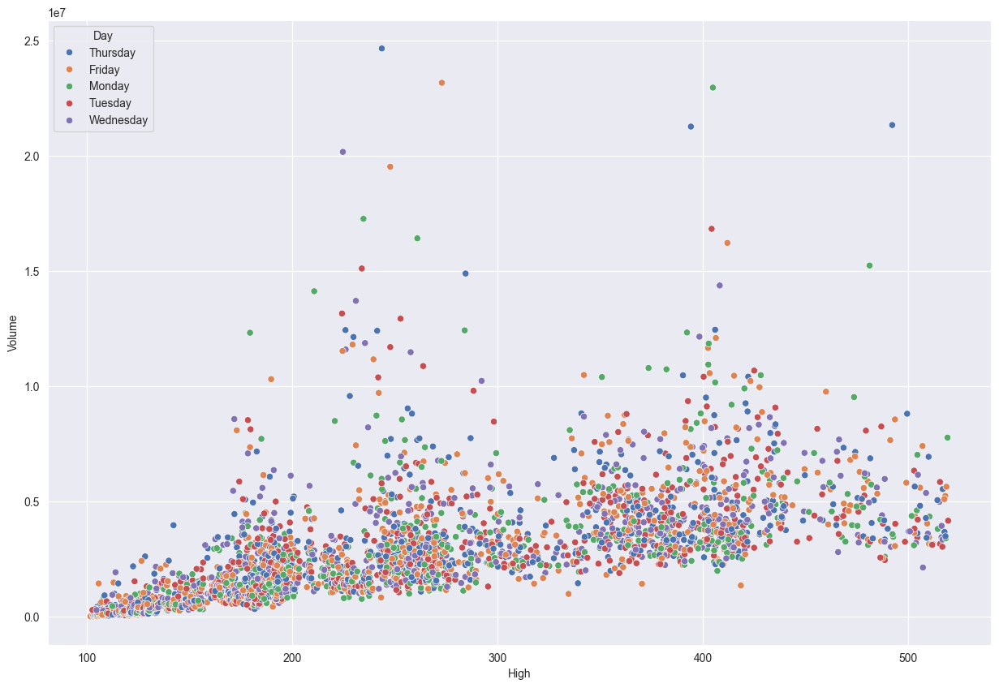

In [20]:
#Plots the scatter distribution of high vs volume vs Day 
fig, ax1 = plt.subplots(figsize=(15,10))
sns.scatterplot(data=df_dummy, x="High", y="Volume", hue="Day", palette="deep", ax=ax1)

### Distribution of Volume by Year

In [21]:
# Defines function to plot distribution of a grouped dataframe

def plot_group(df, title=""):
    plt.figure(figsize=(20, 10))

    #Plotting the pie chart
    plt.subplot(121)
    label_list = list(df.index)
    pie_plot = df.plot.pie(autopct="%.2f%%", colors=sns.color_palette("prism", 7), startangle=60, labels=label_list, wedgeprops={"linewidth": 2, "edgecolor": "k"}, shadow=True, textprops={"fontsize": 16})
    plt.title(title, fontsize=25)

    #Extracting and printing the values of the pie chart
    pie_values = df.values.flatten()
    pie_df = pd.DataFrame({"Pie Values": pie_values}, index=label_list)
    pie_df["Percentage"] = pie_df["Pie Values"] / pie_df["Pie Values"].sum() * 100
    print("Pie chart values (as percentages):")
    pd.set_option('display.float_format', lambda x: '%.2f' % x)
    print(pie_df.to_string(formatters={"Percentage": "{:.2f}%".format}))

    #Plotting the bar chart
    plt.subplot(122)
    ax = df.plot(kind="barh")

    for i, (index, value) in enumerate(zip(df.index, df.values)):
        print(f"Bar {index} - x: {value:.2f}, y: {i}")

    for i, j in enumerate(df.values):
        ax.text(.7,i,j, weight = "bold", fontsize=15)
    
    plt.title(title, fontsize=25)
    plt.show()

Pie chart values (as percentages):
      Pie Values Percentage
2010     4178000      0.04%
2011    56655600      0.60%
2012   100982250      1.07%
2013   255067200      2.69%
2014   329594800      3.48%
2015   514434000      5.43%
2016   599572900      6.33%
2017   493020100      5.21%
2018   796996800      8.42%
2019   694776600      7.34%
2020  1190689200     12.57%
2021  1095440000     11.57%
2022  1452536400     15.34%
2023  1015683100     10.72%
2024   871375800      9.20%
Bar 2010 - x: 4178000.00, y: 0
Bar 2011 - x: 56655600.00, y: 1
Bar 2012 - x: 100982250.00, y: 2
Bar 2013 - x: 255067200.00, y: 3
Bar 2014 - x: 329594800.00, y: 4
Bar 2015 - x: 514434000.00, y: 5
Bar 2016 - x: 599572900.00, y: 6
Bar 2017 - x: 493020100.00, y: 7
Bar 2018 - x: 796996800.00, y: 8
Bar 2019 - x: 694776600.00, y: 9
Bar 2020 - x: 1190689200.00, y: 10
Bar 2021 - x: 1095440000.00, y: 11
Bar 2022 - x: 1452536400.00, y: 12
Bar 2023 - x: 1015683100.00, y: 13
Bar 2024 - x: 871375800.00, y: 14


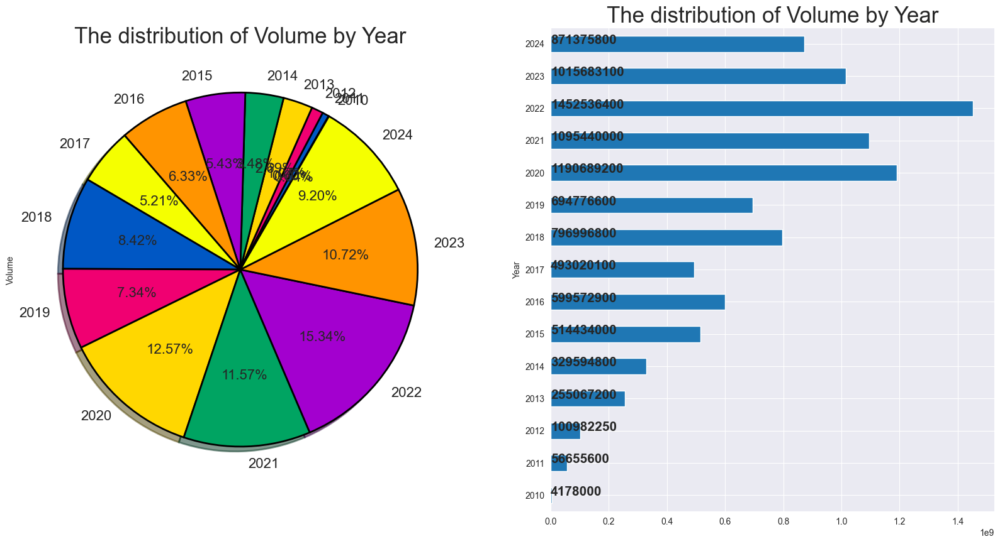

In [22]:
#Plots which year have most volumes
plot_group(df_dummy.groupby('Year')['Volume'].sum(), "The distribution of Volume by Year")

### Distribution of Volume by Day

Pie chart values (as percentages):
           Pie Values Percentage
Friday     1930743300     20.39%
Monday     1713850900     18.10%
Thursday   1966799300     20.77%
Tuesday    1915837950     20.23%
Wednesday  1943771300     20.52%
Bar Friday - x: 1930743300.00, y: 0
Bar Monday - x: 1713850900.00, y: 1
Bar Thursday - x: 1966799300.00, y: 2
Bar Tuesday - x: 1915837950.00, y: 3
Bar Wednesday - x: 1943771300.00, y: 4


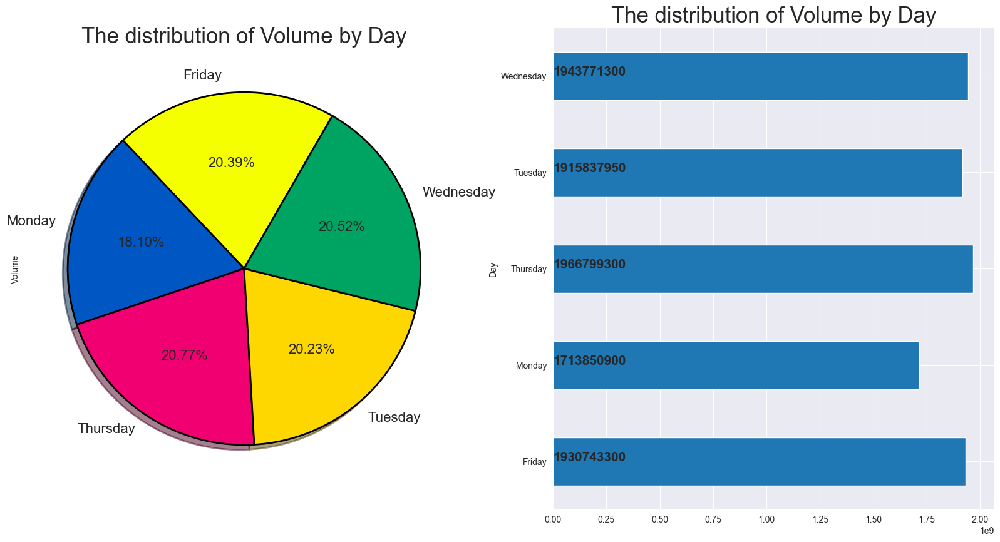

In [23]:
#Plots which days of the week have most volumes
plot_group(df_dummy.groupby('Day')['Volume'].sum(), "The distribution of Volume by Day")

### Distribution of Volume by Month

Pie chart values (as percentages):
           Pie Values Percentage
April       796525700      8.41%
August      765923100      8.09%
December    844334500      8.91%
February    833496450      8.80%
January     927131700      9.79%
July        686906750      7.25%
June        772811700      8.16%
March      1053589650     11.12%
May         753563950      7.96%
November    643286700      6.79%
October     715764800      7.56%
September   677667750      7.16%
Bar April - x: 796525700.00, y: 0
Bar August - x: 765923100.00, y: 1
Bar December - x: 844334500.00, y: 2
Bar February - x: 833496450.00, y: 3
Bar January - x: 927131700.00, y: 4
Bar July - x: 686906750.00, y: 5
Bar June - x: 772811700.00, y: 6
Bar March - x: 1053589650.00, y: 7
Bar May - x: 753563950.00, y: 8
Bar November - x: 643286700.00, y: 9
Bar October - x: 715764800.00, y: 10
Bar September - x: 677667750.00, y: 11


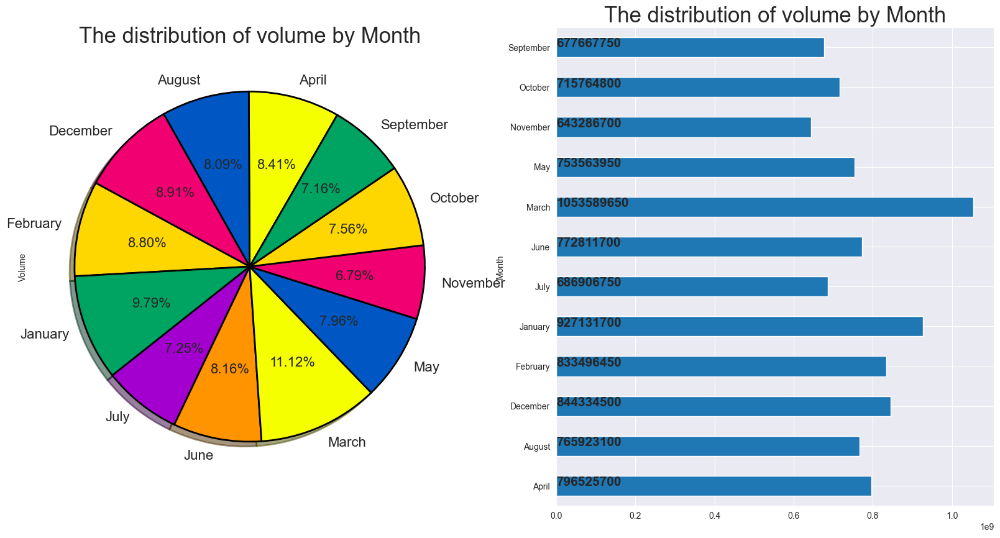

In [24]:
#Plots which month have most volumes
plot_group(df_dummy.groupby('Month')['Volume'].sum(), "The distribution of volume by Month")

### Distribution of Volume by Quarter

Pie chart values (as percentages):
            Pie Values Percentage
April-June  2322901350     24.53%
Jan-March   2814217800     29.71%
July-Sept   2130497600     22.49%
Oct-Dec     2203386000     23.26%
Bar April-June - x: 2322901350.00, y: 0
Bar Jan-March - x: 2814217800.00, y: 1
Bar July-Sept - x: 2130497600.00, y: 2
Bar Oct-Dec - x: 2203386000.00, y: 3


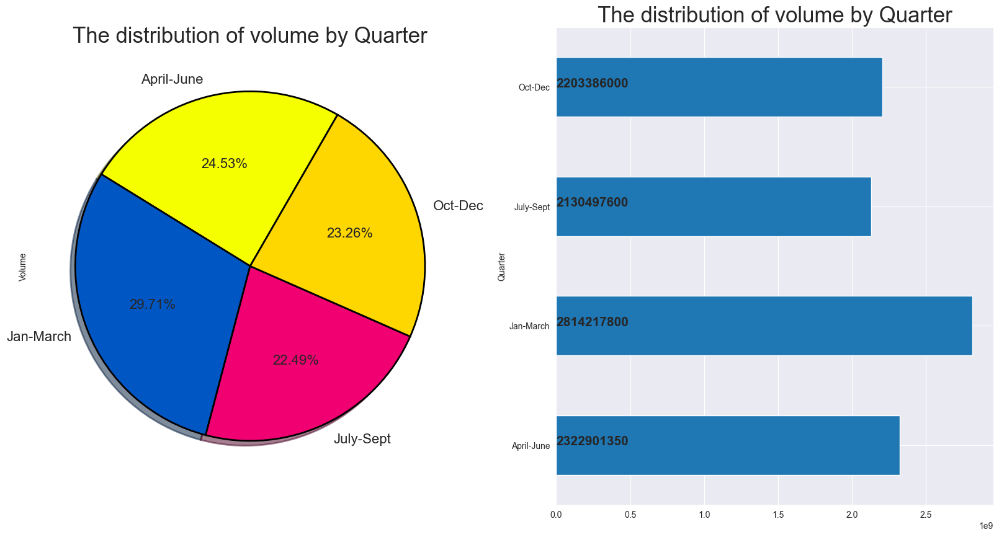

In [25]:
#Plots which quarter have most volumes
plot_group(df_dummy.groupby('Quarter')['Volume'].sum(), "The distribution of volume by Quarter")

### Year-Wise Distribution 

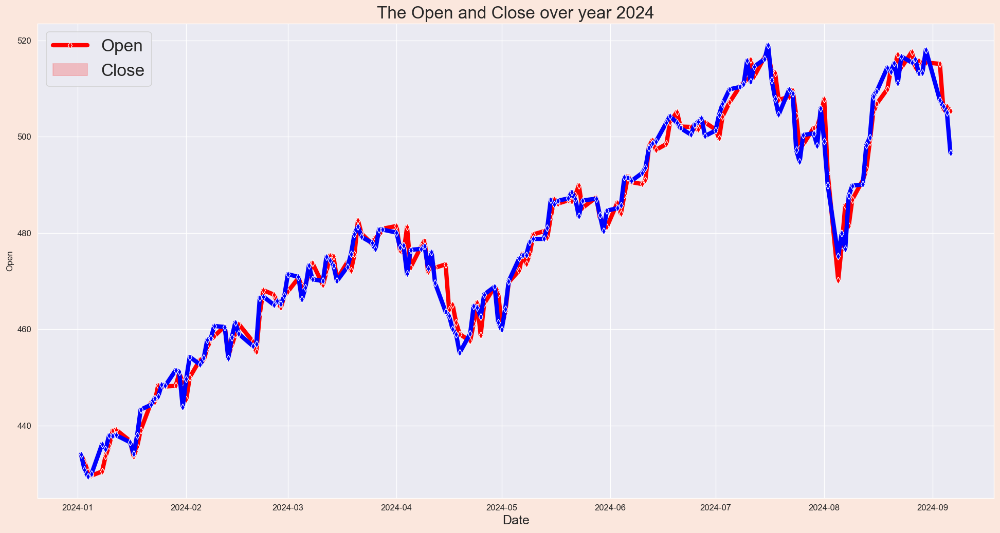

In [82]:
# Plots Open and Close feature over year 2024
plt.subplots(figsize=(20,10), facecolor='#fbe7dd')
plt.xlabel('Date', fontsize=15)
plt.title('The Open and Close over year 2024', fontsize=20)
sns.lineplot(data=df_dummy[df_dummy['Year']==2024]['Open'], color='red', marker='d', linewidth=5)
sns.lineplot(data=df_dummy[df_dummy['Year']==2024]['Close'], color='blue', marker='d', linewidth=5)
plt.legend(['Open', 'Close'], fontsize=20)
plt.show()


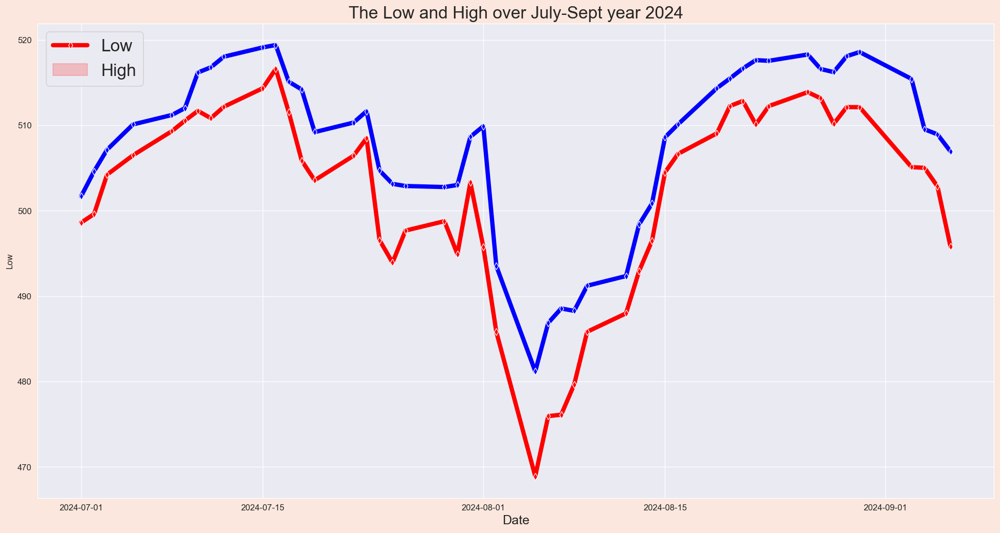

In [83]:
#Plots Low and High features over July-Sept year 2024
plt.subplots(figsize=(20,10), facecolor='#fbe7dd')
plt.xlabel('Date', fontsize=15)
plt.title('The Low and High over July-Sept year 2024', fontsize=20)
sns.lineplot(data=df_dummy[(df_dummy['Year']==2024)&(df_dummy['Quarter']=='July-Sept')]['Low'], color='red', marker='d', linewidth=5)
sns.lineplot(data=df_dummy[(df_dummy['Year']==2024)&(df_dummy['Quarter']=='July-Sept')]['High'], color='blue', marker='d', linewidth=5)
plt.legend(['Low', 'High'], fontsize=20)
plt.show()


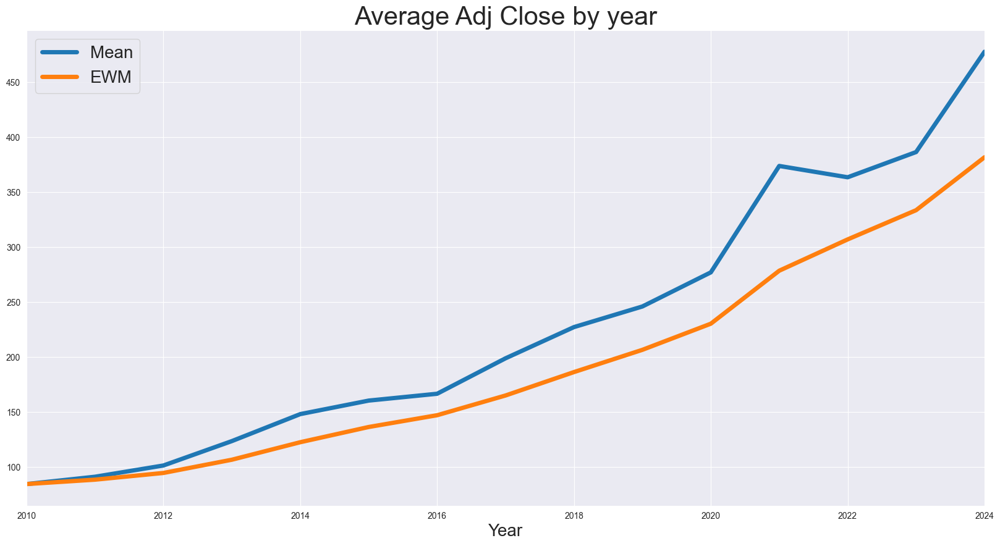

In [28]:
#Plots average Adj Close by year with mean and ewm
fig=plt.figure(figsize=(20,10))
plt.rcParams.update({'figure.dpi':120})
year_data = df.resample('y').mean()
year_data['Adj Close'].plot(linewidth=5)
year_data_ewm = year_data['Adj Close'].ewm(span=5).mean()
year_data_ewm.plot(linewidth=5)
plt.title('Average Adj Close by year', fontsize=30)
plt.xlabel('Year', fontsize=20)
plt.legend(["Mean", "EWM"], fontsize=20)

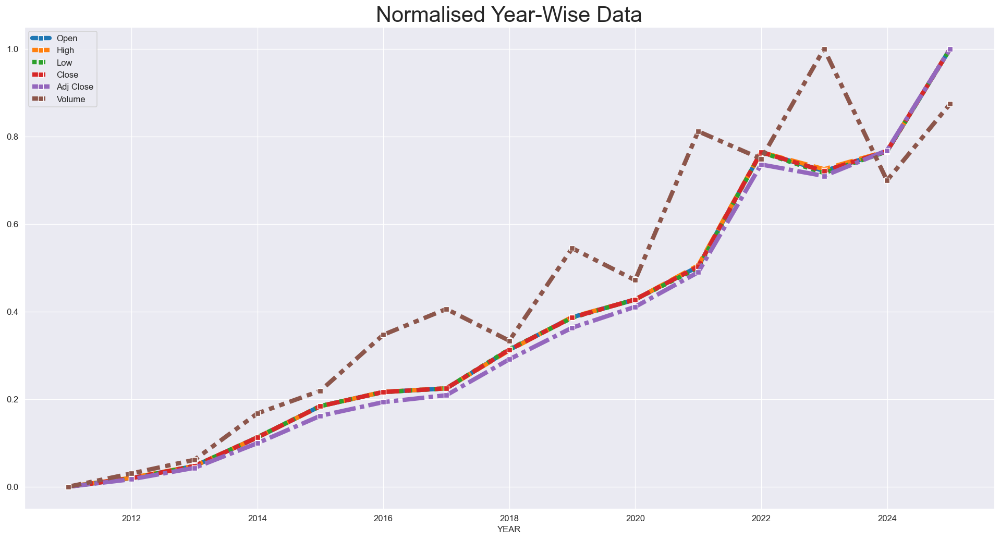

In [29]:
#Normalises year-wise data
cols = list(df_dummy.columns)
cols.remove('Month')
cols.remove('Day')
cols.remove('Week')
cols.remove('Year')
cols.remove('Quarter')
norm_data = (year_data[cols] - year_data[cols].min()) / (year_data[cols].max() - year_data[cols].min())

#Line graph representation of all the year-wise data
plt.figure(figsize=(20,10))
plt.xlabel('YEAR')
plt.title('Normalised Year-Wise Data', fontsize=25)
sns.lineplot(data=norm_data, marker='s', linewidth=5)
plt.show()

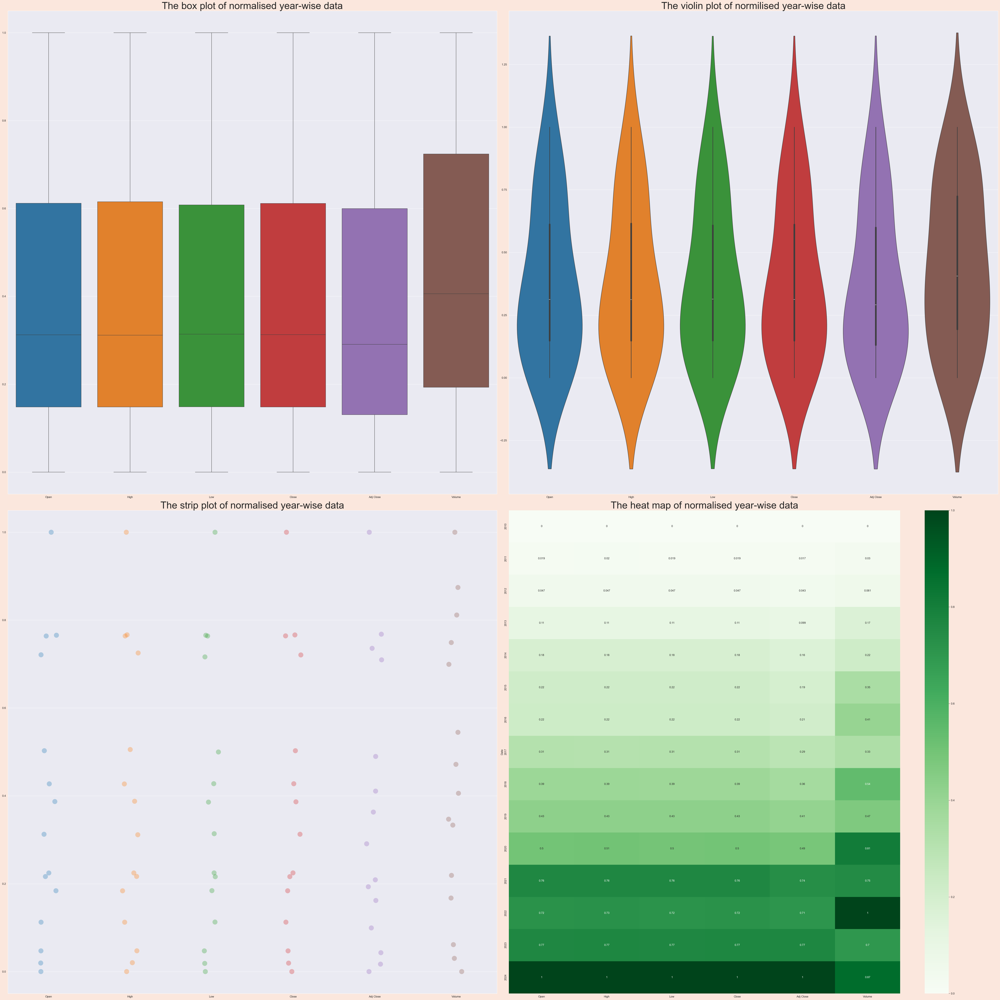

In [30]:
#Plots boxplot, violinplot, stripplot and heatmap of normalised year-wise data
def plot_norm_year_wise_data(norm_data):
    _, ax = plt.subplots(2, 2, figsize=(50,50), facecolor='#fbe7dd')
    g=sns.boxplot(data=norm_data, ax=ax[0,0])
    g.xaxis.get_label().set_fontsize(30)
    g.set_title("The box plot of normalised year-wise data", fontsize=35)

    g=sns.violinplot(data=norm_data, ax=ax[0,1])
    g.xaxis.get_label().set_fontsize(30)
    g.set_title("The violin plot of normilised year-wise data", fontsize=35)

    g=sns.stripplot(data=norm_data, jitter=True, s=18, alpha=0.3, ax=ax[1,0])
    g.xaxis.get_label().set_fontsize(30)
    g.set_title("The strip plot of normalised year-wise data", fontsize=35)

    g=sns.heatmap(data=norm_data, annot=True, cmap='Greens', yticklabels=norm_data.index.year, ax=ax[1,1])
    g.xaxis.get_label().set_fontsize(30)
    g.set_title("The heat map of normalised year-wise data", fontsize=35)
    plt.tight_layout()
    plt.show()

plot_norm_year_wise_data(norm_data)


### Month-Wise Distribution 

In [31]:
#Resample the data month-wise by mean
monthly_data = df_dummy[cols].resample('m').mean()

#Resample the data month-wise by EWM
monthly_data_ewm = monthly_data.ewm(span=5).mean()

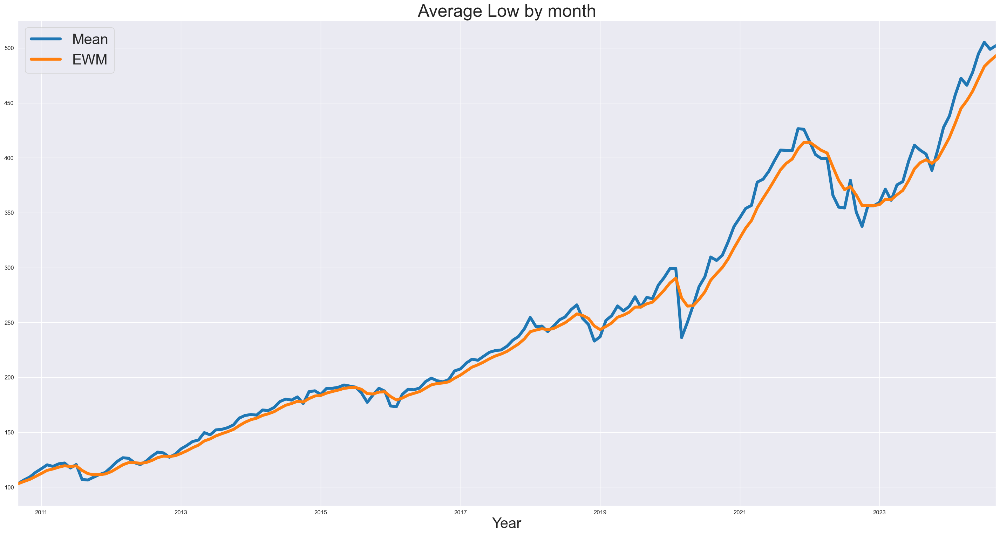

In [32]:
#Plots average Low by month with mean and EWM
fig = plt.figure(figsize=(30,15))
plt.rcParams.update({'figure.dpi':120})
monthly_data['Low'].plot(linewidth=5)
monthly_data_ewm['Low'].plot(linewidth=5)
plt.title('Average Low by month', fontsize=30)
plt.xlabel('Year', fontsize=25)
plt.legend(['Mean', "EWM"], fontsize=25)

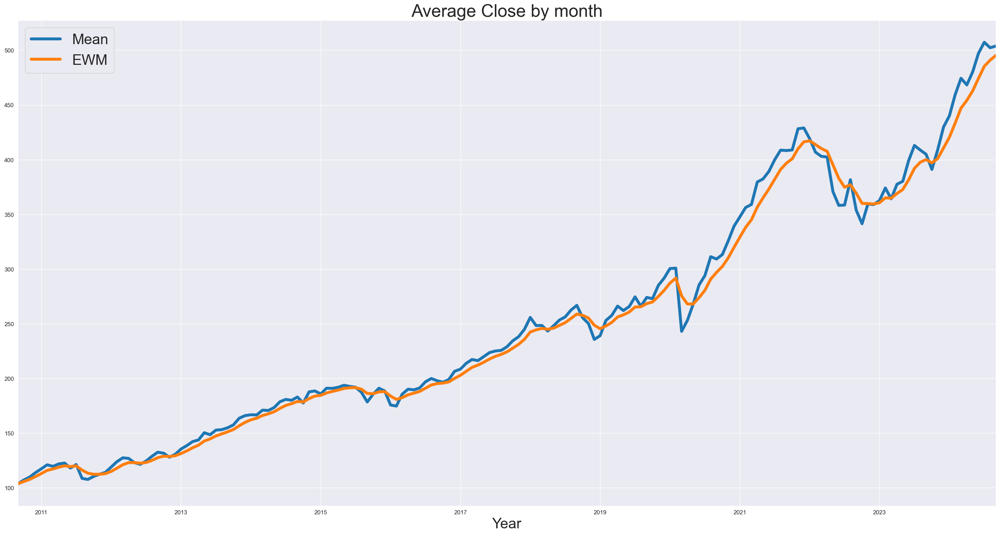

In [33]:
#Plots average Close by month with mean and EWM
fig = plt.figure(figsize=(30,15))
plt.rcParams.update({'figure.dpi':120})
monthly_data['Close'].plot(linewidth=5)
monthly_data_ewm['Close'].plot(linewidth=5)
plt.title('Average Close by month', fontsize=30)
plt.xlabel('Year', fontsize=25)
plt.legend(['Mean', "EWM"], fontsize=25)

In [34]:
def color_month(month):
    if month == 1:
        return 'January', 'blue'
    elif month == 2:
        return 'February', 'green'
    elif month == 3:
        return 'March', 'orange'
    elif month == 4:
        return 'April', 'yellow'
    elif month == 5:
        return 'May', 'red'
    elif month == 6:
        return 'June', 'violet'
    elif month == 7:
        return 'July', 'purple'
    elif month == 8:
        return 'August', 'black'
    elif month == 9:
        return 'September', 'brown'
    elif month == 10:
        return 'October', 'darkblue'
    elif month == 11:
        return 'November', 'grey'
    else:
        return 'December', 'pink'
    

def line_plot_month(month, data):
    label, color = color_month(month)
    mdata = data[data.index.month == month]
    sns.lineplot(data=mdata, label=label, color=color, marker='o', linewidth=5)


def sns_plot_month(title, feat):
    plt.figure(figsize=(25,10))
    plt.title(title, fontsize=40)
    plt.xlabel('YEAR', fontsize=30)
    plt.ylabel(feat, fontsize=30)

    for i in range(1,13):
        line_plot_month(i, monthly_data[feat])
    plt.show()

<Figure size 3000x1200 with 0 Axes>

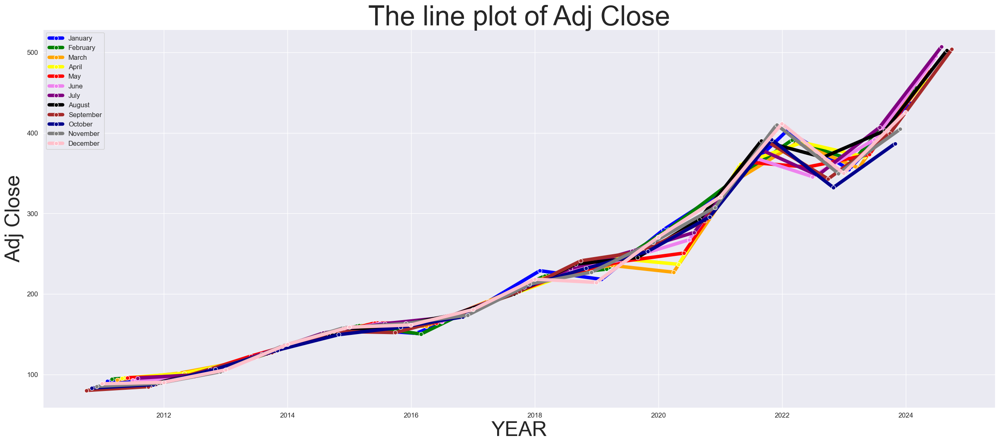

In [35]:
#Plots line graph of month-wise Adj Close feature each month all year 
plt.figure(figsize=(25,10))
title='The line plot of Adj Close'
sns_plot_month(title, "Adj Close")

<Figure size 3000x1200 with 0 Axes>

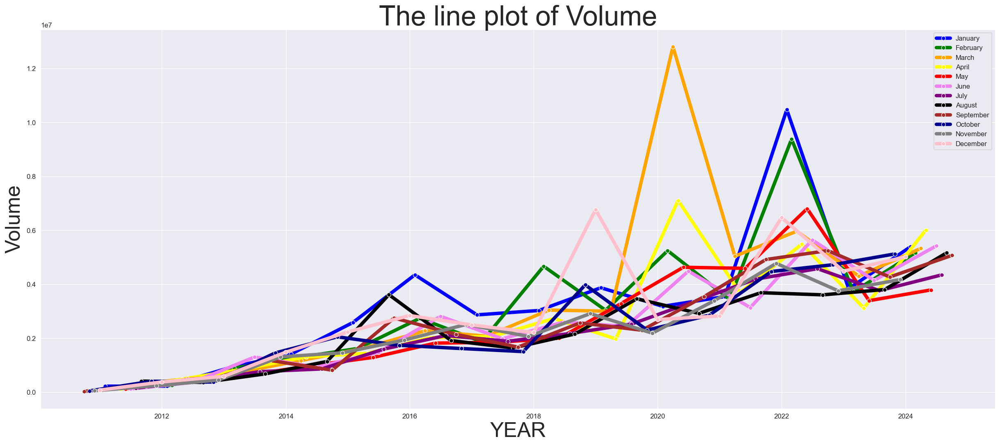

In [36]:
#Plots line graph of month-wise Volume feature each month all year 
plt.figure(figsize=(25,10))
title='The line plot of Volume'
sns_plot_month(title, "Volume")

            Open  High  Low  Close  Adj Close  Volume
Date                                                 
2010-09-30  0.00  0.00 0.00   0.00       0.00    0.00
2010-10-31  0.01  0.01 0.01   0.01       0.01    0.00
2010-11-30  0.01  0.01 0.02   0.02       0.01    0.00
2010-12-31  0.02  0.02 0.03   0.03       0.02    0.00
2011-01-31  0.03  0.03 0.03   0.03       0.03    0.01


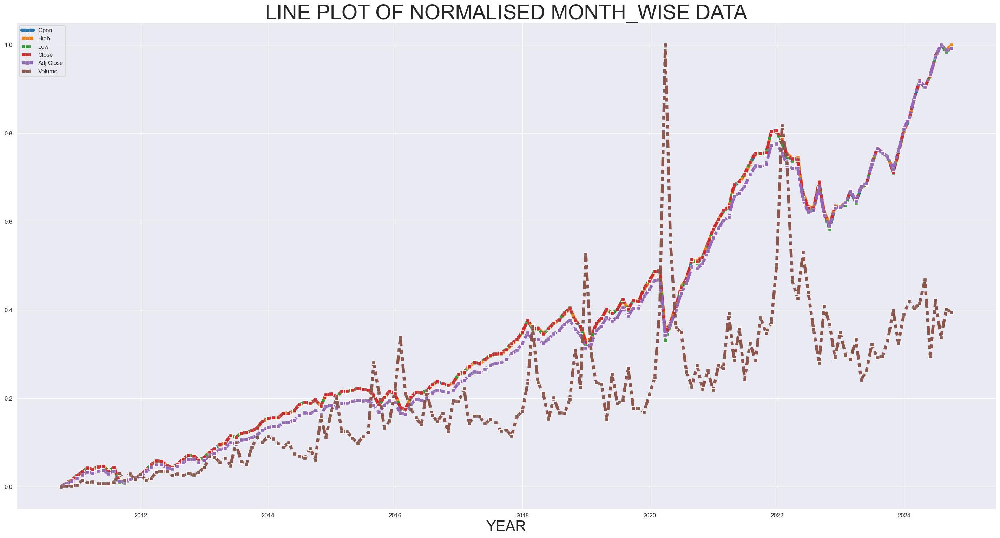

In [37]:
#Normalises month-wise data
norm_data_monthly = (monthly_data - monthly_data.min()) / (monthly_data.max() - monthly_data.min())
print(norm_data_monthly.head().to_string())

#Line graph representing af all the month-wise data
plt.figure(figsize=(30,15))
plt.xlabel('YEAR', fontsize=25)
plt.title('LINE PLOT OF NORMALISED MONTH_WISE DATA', fontsize=35)
sns.lineplot(data=norm_data_monthly, marker='s', linewidth=5)
plt.show()

In [38]:
# Plots boxplot, violplot, stripplot and lineplot of normalised month-wise data
def plot_norm_month_wise_data(norm_data, month, title):
    label = color_month(month)[0]
    data = norm_data[norm_data.index.month == month]
    _,ax = plt.subplots(2,2, figsize=(40,20), facecolor='#fbe7dd')

    g=sns.boxplot(data=data, ax = ax[0,0])
    g.xaxis.get_label().set_fontsize(30)
    g.set_title("The box plot of normalised month-wise data in " + label, fontsize=35)

    g=sns.violinplot(data=data, ax = ax[0,1])
    g.xaxis.get_label().set_fontsize(30)
    g.set_title("The violin plot of normalised month-wise data in " + label, fontsize=35)

    g=sns.stripplot(data=data, jitter=True, s=18, alpha=0.3, ax = ax[1,0])
    g.xaxis.get_label().set_fontsize(30)
    g.set_title("The strip plot of normalised month-wise data in " + label, fontsize=35)

    g=sns.lineplot(data=data, marker='s', linewidth=5, ax = ax[1,1])
    g.xaxis.get_label().set_fontsize(30)
    g.set_title("The line plot of normalised month-wise data in " + label, fontsize=35)
    g.set_xlabel('YEAR')
    plt.suptitle(title + " in " + label, fontsize=45)
    plt.subplots_adjust(top=0.9)
    plt.show()





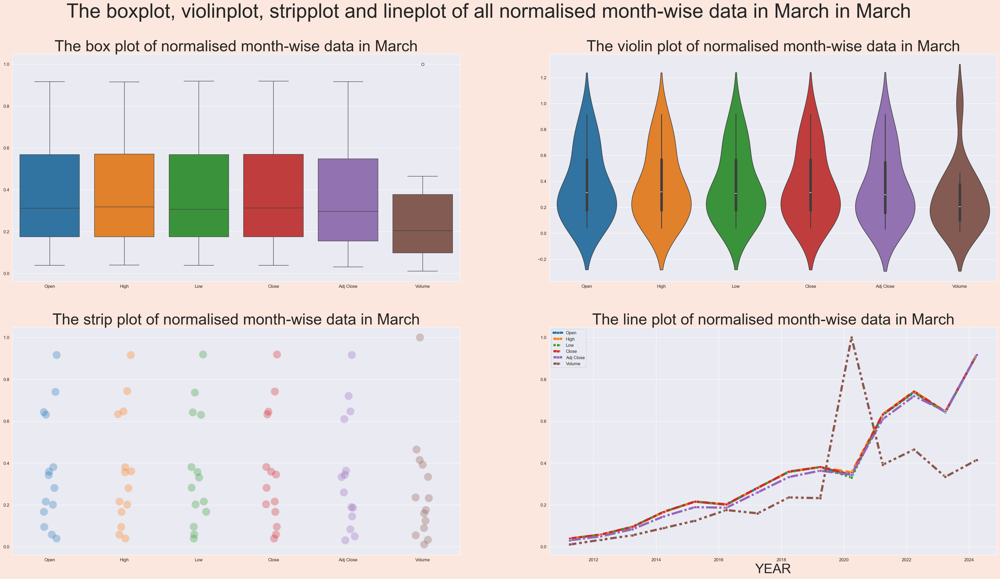

In [39]:
#Plots boxplot, violinplot, stripplot and lineplot of normalised month-wise in March
title = "The boxplot, violinplot, stripplot and lineplot of all normalised month-wise data in March"
plot_norm_month_wise_data(norm_data_monthly,3,title)

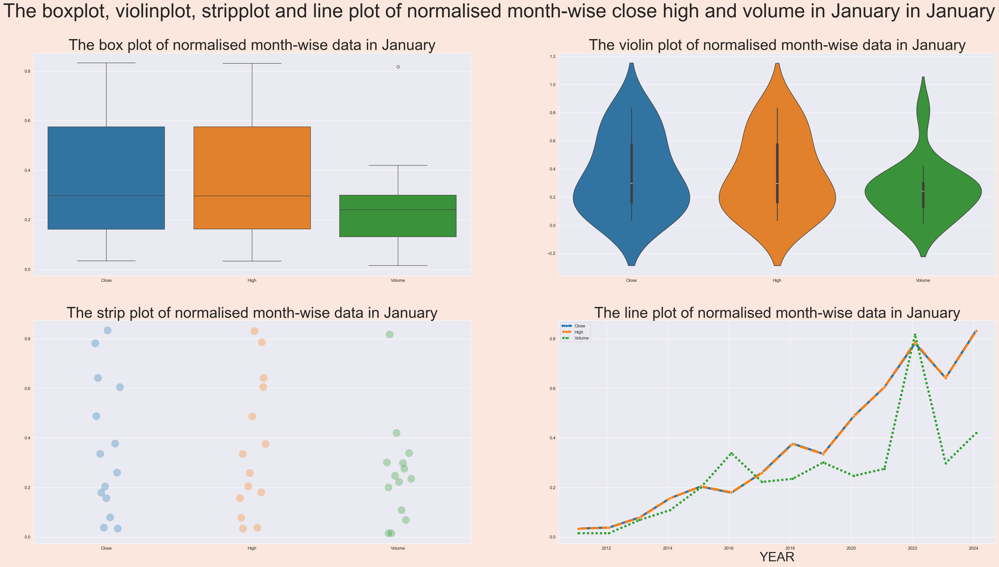

In [40]:
#Plots boxplot, violinplot, stripplot and lineplot of normalised month-wise close, high, and volume in January
title = "The boxplot, violinplot, stripplot and line plot of normalised month-wise close high and volume in January"
plot_norm_month_wise_data(norm_data_monthly[['Close', 'High', 'Volume']], 1, title)

# Forecasting Adjusted Closing Using Machine Learning 

### Computing Technical Indicators

In [41]:
def compute_daily_returns(df):
    '''Compute and return the daily return values'''
    # TODO: Your code here
    # Note: Returned Dataframe must have the same number of rows
    daily_return = (df/df.shift(1)) - 1
    daily_return[0] = 0
    return daily_return
df['daily_returns'] = compute_daily_returns(df['Adj Close'])

### Scatter Distribution of Adj Close vs Daily Returns vs Year 

<Axes: xlabel='Adj Close', ylabel='daily_returns'>

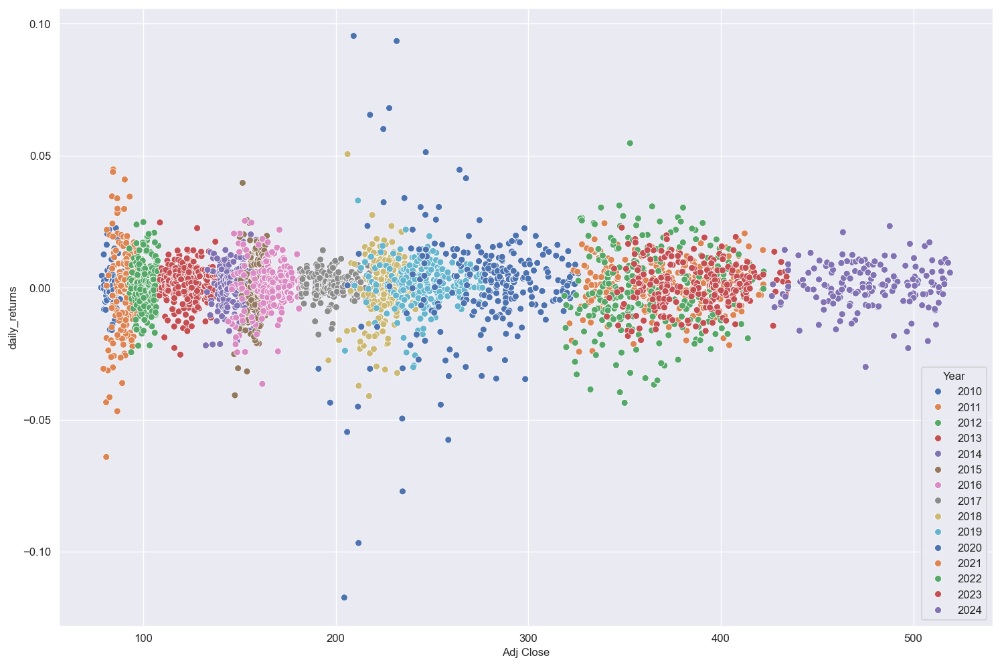

In [42]:
#Plots the scatter distribution of close vs daily_returns vs Year
fig, ax1 = plt.subplots(figsize=(15,10))
sns.scatterplot(data=df, x="Adj Close", y='daily_returns', hue="Year", palette="deep", ax=ax1)

### Scatter distribution of Volume vs Daily Returns vs Year


<Axes: xlabel='Volume', ylabel='daily_returns'>

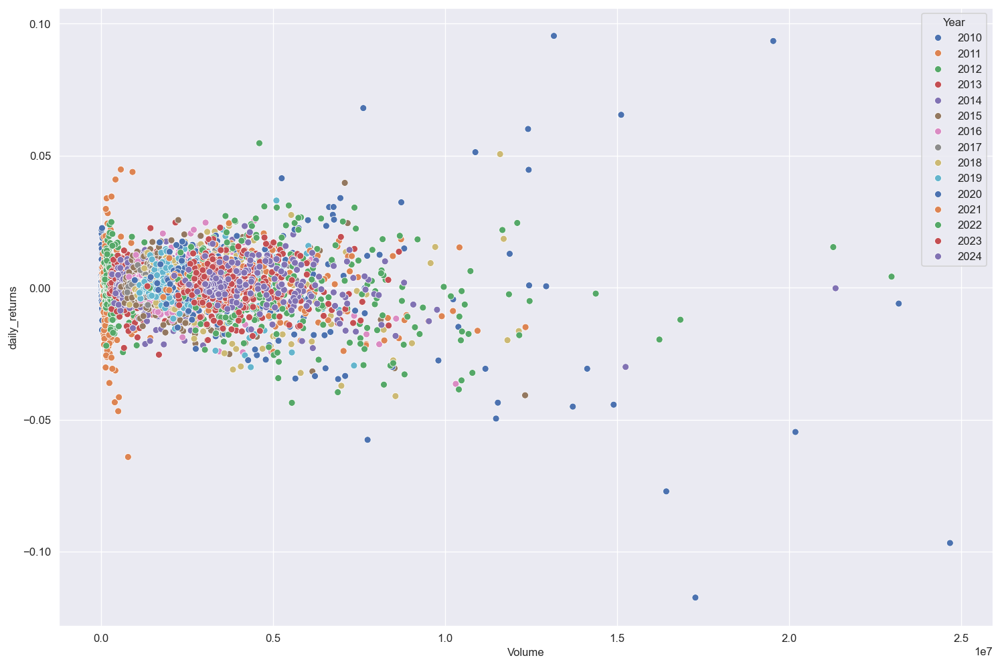

In [43]:
#Plots the scatter distribution of Volume vs daily_returns versus Year
fig, ax1 = plt.subplots(figsize=(15,10))
sns.scatterplot(data=df, x='Volume', y="daily_returns", hue="Year", palette="deep", ax=ax1)

### Computing MACD

In [44]:
def calculate_MACD(df, nslow=26, nfast=12):
    emaslow = df.ewm(span=nslow, min_periods=nslow, adjust=True, ignore_na=False).mean()
    emafast = df.ewm(span=nfast, min_periods=nfast, adjust=True, ignore_na=False).mean()
    dif = emafast - emaslow
    MACD = dif.ewm(span=9, min_periods=9, adjust=True, ignore_na=False).mean()
    return dif, MACD

### Computing RSI

In [45]:
def calculate_RSI(df, periods=14):
    # wilder's RSI
    delta = df.diff()
    up, down = delta.copy(), delta.copy()
    up[up < 0] = 0
    down[down > 0] = 0 

    rUp = up.ewm(com=periods, adjust=False).mean()
    rDown = down.ewm(com=periods, adjust=False).mean().abs()

    rsi = 100 - 100 / (1 + rUp / rDown)
    return rsi

### Computing SMA

In [46]:
def calculate_SMA(df, periods=15):
    SMA = df.rolling(window=periods, min_periods=periods, center=False).mean()
    return SMA

### Computing Bollinger Bands

In [47]:
def calculate_BB(df, periods=15):
    STD = df.rolling(window=periods, min_periods=periods, center=False).std()
    SMA = calculate_SMA(df)
    upper_band = SMA + (2 * STD)
    lower_band = SMA - (2 * STD)
    return upper_band, lower_band


def calculate_stdev(df, periods=5):
    STDEV = df.rolling(periods).std()
    return STDEV

### Plotting Technical Indicators 

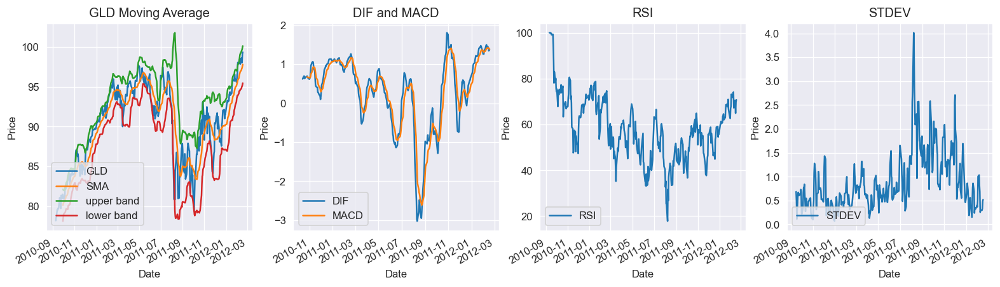

In [48]:
#Plots MACD, SMA, RSI, upper and lower bands and std of Adj Close column
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(16, 4))
stock_close = df["Adj Close"]

#Calculates Simple Moving Average for Adj Close
SMA_CLOSE = calculate_SMA(stock_close)
stock_close[:365].plot(title="GLD Moving Average", label="GLD", ax=axes[0])
SMA_CLOSE[:365].plot(label="SMA", ax=axes[0])

#Calculates Bollinger Bands for Adj Close
upper_band, lower_band = calculate_BB(stock_close)
upper_band[:365].plot(label='upper band', ax = axes[0])
lower_band[:365].plot(label='lower band', ax=axes[0])

#Calculates MACD for Adj Close 
DIF, MACD = calculate_MACD(stock_close)
DIF[:365].plot(title='DIF and MACD', label='DIF', ax=axes[1])
MACD[:365].plot(label='MACD', ax=axes[1])

#Calculates RSI for Adj Close 
RSI = calculate_RSI(stock_close)
RSI[:365].plot(title='RSI', label='RSI', ax=axes[2])

#Calculates Standard deviation for Adj Close
STDEV = calculate_stdev(stock_close)
STDEV[:365].plot(title="STDEV", label='STDEV', ax=axes[3])

axes[0].set_ylabel('Price')
axes[1].set_ylabel('Price')
axes[2].set_ylabel('Price')
axes[3].set_ylabel('Price')

axes[0].legend(loc='lower left')
axes[1].legend(loc='lower left')
axes[2].legend(loc='lower left')
axes[3].legend(loc='lower left')

### Plotting the difference

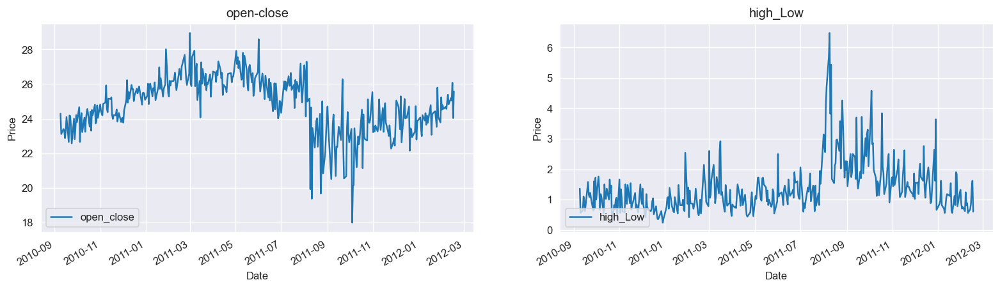

In [50]:
# Plots the difference of Open and Close and the difference of High and Low
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 4))
Open_Close = df.Open - df["Adj Close"]
Open_Close[:365].plot(title='open-close', label='open_close', ax = axes[0])

High_Low = df.High - df.Low
High_Low[:365].plot(title='high_Low', label='high_Low', ax = axes[1])
axes[0].set_ylabel('Price')
axes[1].set_ylabel('Price')
axes[0].legend(loc='lower left')
axes[1].legend(loc='lower left')

### Preprocessing data

In [51]:
X = df.copy()
X['SMA'] = SMA_CLOSE
X["Upper_band"] = upper_band
X["Lower_band"] = lower_band
X["DIF"] = DIF
X["MACD"] = MACD
X['RSI'] = RSI
X['STDEV'] = STDEV
X['Open_Close'] = Open_Close
X['High_Low'] = High_Low

#Sets target Column
y_final = pd.DataFrame(X['Close'])
X = X.drop(["Adj Close"], axis=1)

#Checks null values because of technical indicators
print('Total number of null values : ', X.isnull().sum().sum())

#Fills each null value in every column with mean value
cols = list(X.columns)
for n in cols:
    X[n].fillna(X[n].mean(), inplace=True)

#Checks again null values 
print(X.isnull().sum().to_string())
print('Total number of null values: ', X.isnull().sum().sum())

#Normalises data
scaler = MinMaxScaler()
X_minmax_data = scaler.fit_transform(X)
X_final = pd.DataFrame(columns=X.columns, data=X_minmax_data, index=X.index)
print('Shape of features : ', X_final.shape)
print('Shape of target : ', y_final.shape)

#Shifts target array to predict the n + 1 samples
n=90
y_final = y_final.shift(-1)
y_val = y_final[-n:-1]
y_final = y_final[:-n]

#Takes last n rows of data to validation set
X_val = X_final[-n:-1]
X_final = X_final[:-n]

print("\n -----After process----- \n")
print('Shape of features : ', X_final.shape)
print('Shape of target : ', y_final.shape)
print(y_final.tail().to_string())

y_final = y_final.astype('float64')

#Splits data into training and test data at 90% and 10% respectively
split_idx = round(0.9*len(X))
print('split_idx=', split_idx)
X_train = X_final[:split_idx]
y_train = y_final[:split_idx]
X_test = X_final[split_idx:]
y_test = y_final[split_idx:]


Total number of null values :  105
Open             0
High             0
Low              0
Close            0
Volume           0
Day              0
Month            0
Year             0
Week             0
Quarter          0
daily_returns    0
SMA              0
Upper_band       0
Lower_band       0
DIF              0
MACD             0
RSI              0
STDEV            0
Open_Close       0
High_Low         0
Total number of null values:  0
Shape of features :  (3522, 20)
Shape of target :  (3522, 1)

 -----After process----- 

Shape of features :  (3432, 20)
Shape of target :  (3432, 1)
            Close
Date             
2024-04-23 464.50
2024-04-24 462.58
2024-04-25 467.21
2024-04-26 468.84
2024-04-29 461.43
split_idx= 3170


### Performing Regression

In [52]:
def perform_regression(model, X, y, xtrain, ytrain, xtest, ytest, xval, yval, label, feat):
    Trr=[]; Tss=[]
    model.fit(xtrain, ytrain)
    predictions_test = model.predict(xtest)
    predictions_train = model.predict(xtrain)
    predictions_val = model.predict(xval)

    str_label = 'RMSE using ' + label
    print(str_label + f': {np.sqrt(mean_squared_error(ytest, predictions_test))}')
    print('mean square error: ', mean_squared_error(ytest, predictions_test))
    print('variance or r-squared: ', explained_variance_score(ytest, predictions_test))
    print('ACTUAL: Avg. ' + feat + f':{df[feat].mean()}')
    print('ACTUAL: Median ' + feat + f':{df[feat].median()}')
    print('PREDICTED: Avg. ' + feat + f':{predictions_test.mean()}')
    print('PREDICTED: Median' + feat + f':{np.median(predictions_test)}')

    #Evaluation of regression an all dataset
    all_pred = model.predict(X)
    print(('mean square error (whole dataset): ', mean_squared_error(y, all_pred)))
    print('variance or r-squared (whole dataset): ', explained_variance_score(y, all_pred))

    #Visualises the training set results in a scatter plot
    fig, axs = plt.subplots(3, figsize=(25,20), facecolor='#fbe7dd')
    axs[0].scatter(x=ytrain, y=predictions_train, color='blue')
    axs[0].set_title('The scatter of actual vs predicted Concrete compressive strength (Training set): ' + label, fontweight='bold', fontsize=20)
    axs[0].set_xlabel('Actual Train Set', fontsize=20)
    axs[0].set_ylabel('Predicted Train Set', fontsize=20)
    axs[0].plot([ytrain.min(), ytrain.max()], [ytrain.min(), ytrain.max()], 'r--', linewidth=3)

    #Visualises the test set results in a scatter plot
    axs[1].scatter(x=ytest, y=predictions_test, color='red')
    axs[1].set_title('The scatter of actual vs predicted Concrete compressive strength (Test set): ' + label, fontweight='bold', fontsize=20)
    axs[1].plot([ytest.min(), ytest.max()], [ytest.min(), ytest.max()], 'b--', linewidth=3)
    axs[1].set_xlabel('Actual Test Set', fontsize=20)
    axs[1].set_ylabel('Predicted Test Set', fontsize=20)

    #Visualises the validation set results in a scatter plot
    axs[2].scatter(x=yval, y=predictions_val, color='red')
    axs[2].set_title('The scatter of actual vs predicted Concrete compressive strength (Validation set): ' + label, fontweight='bold', fontsize=20)
    axs[2].plot([yval.min(), yval.max()], [yval.min(), yval.max()], 'b--', linewidth=3)
    axs[2].set_xlabel('Actual Validation Set', fontsize=20)
    axs[2].set_ylabel('Predicted Validation Set', fontsize=20)

    #Visualises the density of error of training and testing
    fig, axs = plt.subplots(figsize=(25,10), facecolor='#fbe7dd')
    sns.distplot(np.array(ytrain - predictions_train.reshape(len(ytrain),1)), ax=axs, color='red', kde_kws=dict(linewidth=5))
    axs.set_xlabel('Error', fontsize=20)
    sns.distplot(np.array(ytest - predictions_test.reshape(len(ytest),1)), ax=axs, color='blue', kde_kws=dict(linewidth=5))
    sns.distplot(np.array(yval - predictions_val.reshape(len(yval),1)), ax=axs, color='green', kde_kws=dict(linewidth=5))
    axs.set_title('The density of training,  testing and validation errors: ' + label, fontsize=20, fontweight='bold')
    axs.set_xlabel('Error', fontsize=20)
    axs.legend(['Training Error', 'Testing Error', 'Validation Error'], prop={'size': 15})

    #Histogram distribution of regression on train data 
    fig, axs = plt.subplots(2, figsize=(30,15), facecolor='#fbe7dd')
    sns.histplot(predictions_train, ax=axs[0], kde = True, bins=50, color='red', line_kws={'lw':7})
    sns.histplot(ytrain, ax=axs[0], kde=True, bins=50, color='blue', line_kws={'lw':7})
    axs[0].set_title('Histogram Distribution of ' + label + ' on ' + feat + ' feature on train data', fontsize=20, fontweight='bold')
    axs[0].set_xlabel(feat, fontsize=15)
    axs[0].set_ylabel('Count', fontsize=15)
    axs[0].legend(['Prediction', 'Actual'], prop={'size':15})
    for p in axs[0].patches:
        axs[0].annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0,10), weight='bold', fontsize=20, textcoords='offset points')
    
    #Histogram distribution of regression on test data
    sns.histplot(predictions_test, ax=axs[1], kde=True, bins=50, color='red', line_kws={'lw':7})
    sns.histplot(ytest, ax=axs[1], kde=True, bins=50, color='blue', line_kws={'lw': 7})
    axs[1].set_title('Histogram Distribution of ' + label + ' on ' + feat + 'feature on test data', fontsize=20, fontweight='bold')
    axs[1].set_xlabel(feat, fontsize=15)
    axs[1].set_ylabel('Count', fontsize=15)
    axs[1].legend(['Prediction', "Actual"])

    for p in axs[1].patches:
        axs[1].annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0,10), weight='bold', fontsize=20, textcoords='offset points')

    fig, axs = plt.subplots(4, figsize=(30,30), facecolor='#fbe7dd')
    axs[0].plot(X.index[:split_idx], ytrain, color='blue', linewidth=3, linestyle='-', label='Actual')
    axs[0].plot(X.index[:split_idx], predictions_train, color='red', linewidth=3, linestyle='-', label="Predicted")
    axs[0].set_title('Actual and Predicted Training Set: ' + label, fontsize=35)
    axs[0].set_xlabel('Date', fontsize=20)
    axs[0].set_ylabel(feat, fontsize=16)
    axs[0].legend(prop={'size':20})

    axs[1].plot(X.index[split_idx:], ytest, color='blue', linewidth=3, linestyle='-', label='Actual')
    axs[1].plot(X.index[split_idx:], predictions_test, color='red', linewidth=3, linestyle='-', label="Predicted")
    axs[1].set_title('Actual and Predicted Test Set: ' + label, fontsize=35)
    axs[1].set_xlabel('Date', fontsize=20)
    axs[1].set_ylabel(feat, fontsize=16)
    axs[1].legend(prop={'size':20})

    axs[2].plot(yval.index, yval, color='blue', linewidth=3, linestyle='-', label='Actual')
    axs[2].plot(yval.index, predictions_val, color='red', linewidth=3, linestyle='-', label="Predicted")
    axs[2].set_title('Actual and Predicted Validation Set (90 days forecasting): ' + label, fontsize=35)
    axs[2].set_xlabel('Date', fontsize=20)
    axs[2].set_ylabel(feat, fontsize=16)
    axs[2].legend(prop={'size':20})

    axs[3].plot(X_final.index, y, color='blue', linewidth=3, linestyle='-', label='Actual')
    axs[3].plot(X_final.index, all_pred, color='red', linewidth=3, linestyle='-', label="Predicted")
    axs[3].set_title('Actual and Predicted Whole Dataset: ' + label, fontsize=35)
    axs[3].set_xlabel('Date', fontsize=20)
    axs[3].set_ylabel(feat, fontsize=16)
    axs[3].legend(prop={'size':20})




In [63]:
def predict_next_day_return(model, X, last_price):
    """Predict the next day stock price."""
    # Predict the next day return
    next_day_price = model.predict(X[-1:]).flatten()[0]
    print(f"Next day stock price will be: ${next_day_price:.5f}")
    
    return next_day_price


### Linear Regression

RMSE using Linear Regression: 3.1924577282097193
mean square error:  10.191786346405962
variance or r-squared:  0.9895614417568583
ACTUAL: Avg. Adj Close:229.82783360988077
ACTUAL: Median Adj Close:201.40789
PREDICTED: Avg. Adj Close:421.3529724871483
PREDICTED: MedianAdj Close:413.69722974274885
('mean square error (whole dataset): ', 7.897177760012964)
variance or r-squared (whole dataset):  0.9992229818844544
Next day stock price will be: $469.25652


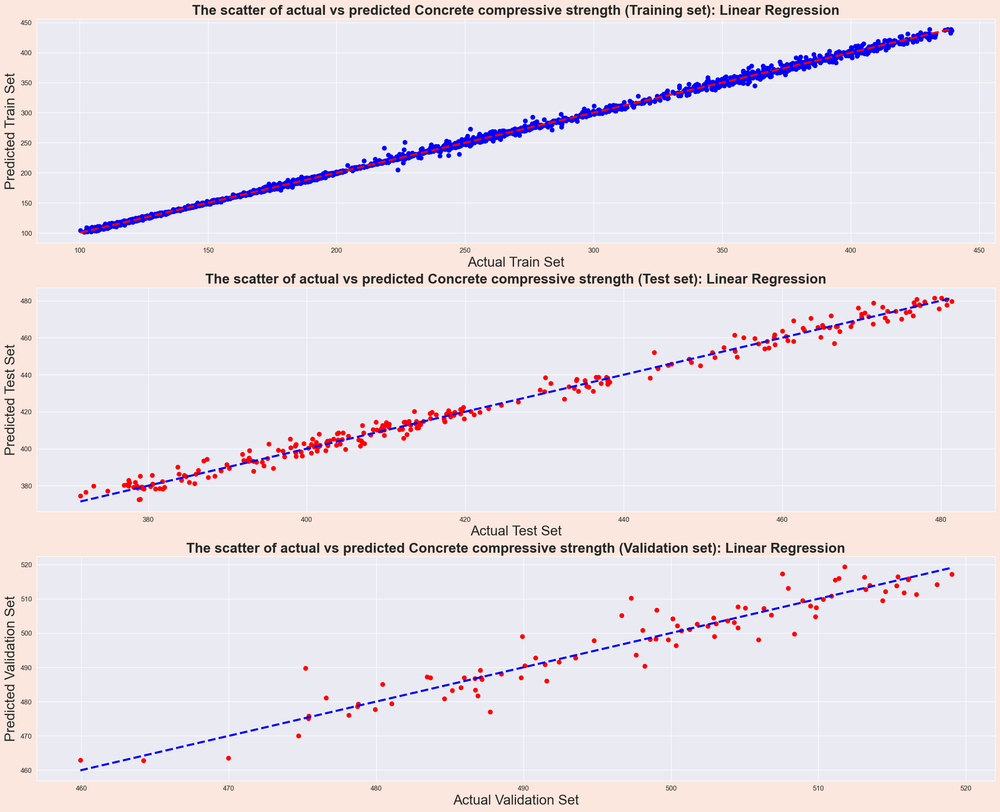

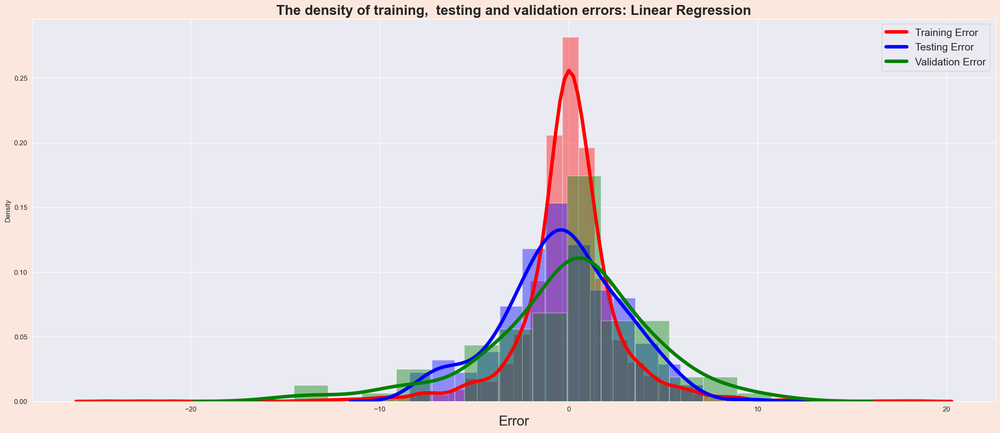

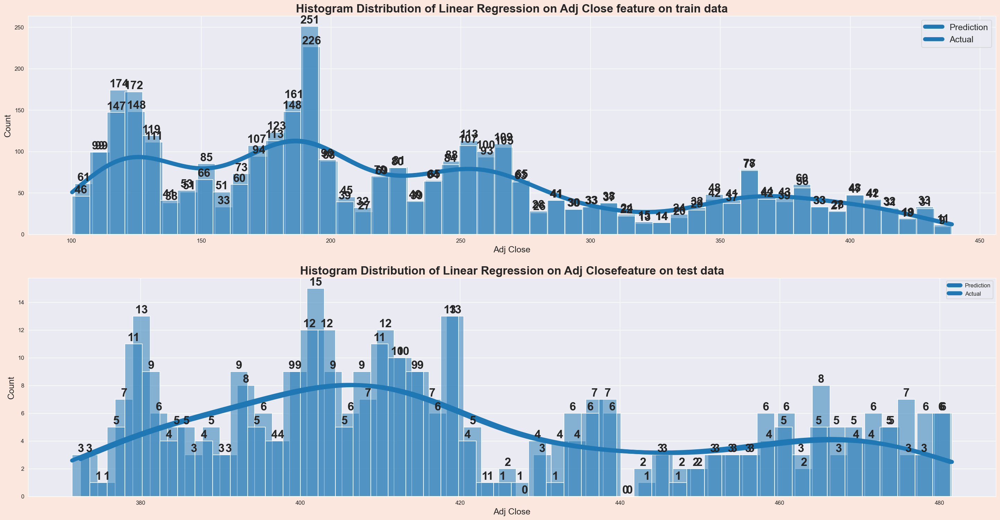

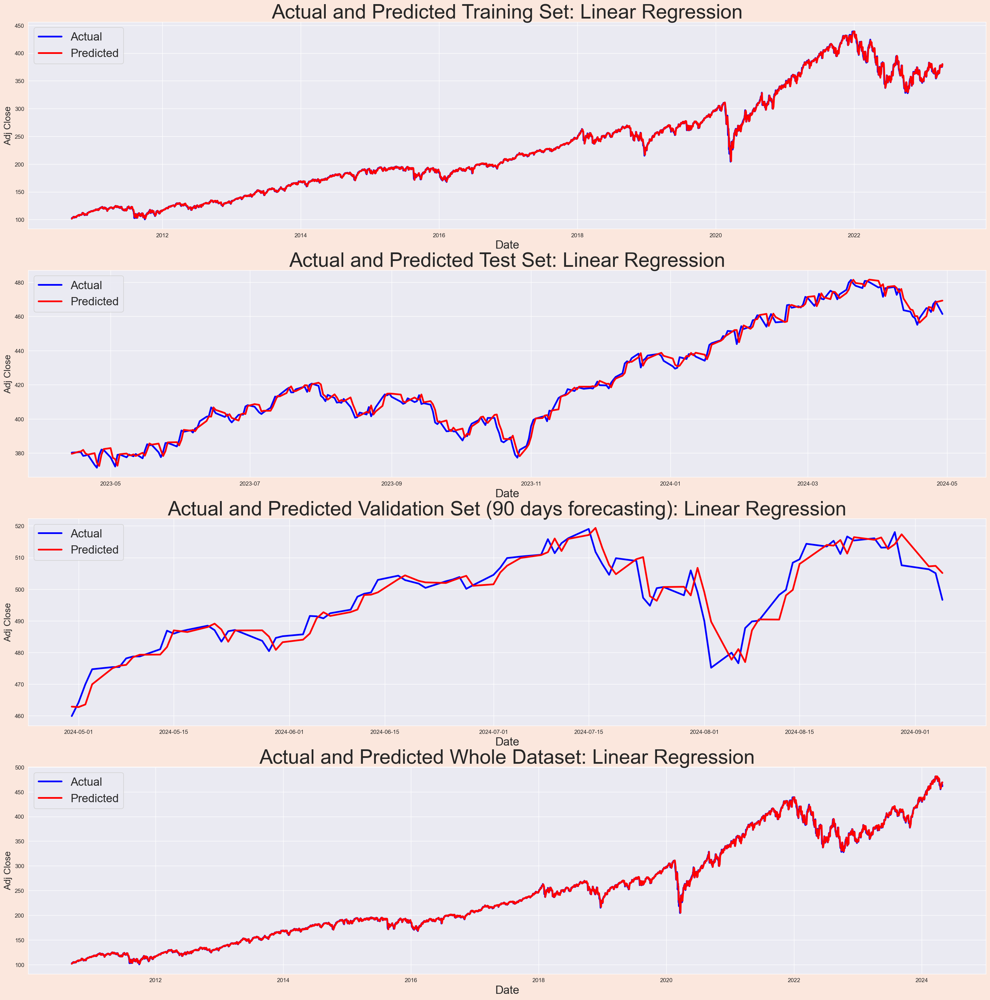

In [65]:
#Linear Regression
lin_reg = LinearRegression()
perform_regression(lin_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, 'Linear Regression', 'Adj Close')

# Train your model with the regression function you already defined
# Assuming you have trained the model, let's predict the next day's return
last_price = df['Adj Close'].iloc[-1]  # Last available price in your dataset

next_day_price = predict_next_day_return(lin_reg, X_final, last_price)

### Random Forest Regression

RMSE using RF Regression: 18.06223318888376
mean square error:  326.24426776961394
variance or r-squared:  0.7583357772182189
ACTUAL: Avg. Adj Close:229.82783360988077
ACTUAL: Median Adj Close:201.40789
PREDICTED: Avg. Adj Close:411.35593538484727
PREDICTED: MedianAdj Close:412.339447455
('mean square error (whole dataset): ', 26.07672144791066)
variance or r-squared (whole dataset):  0.9974883227007261
Next day stock price will be: $432.38770


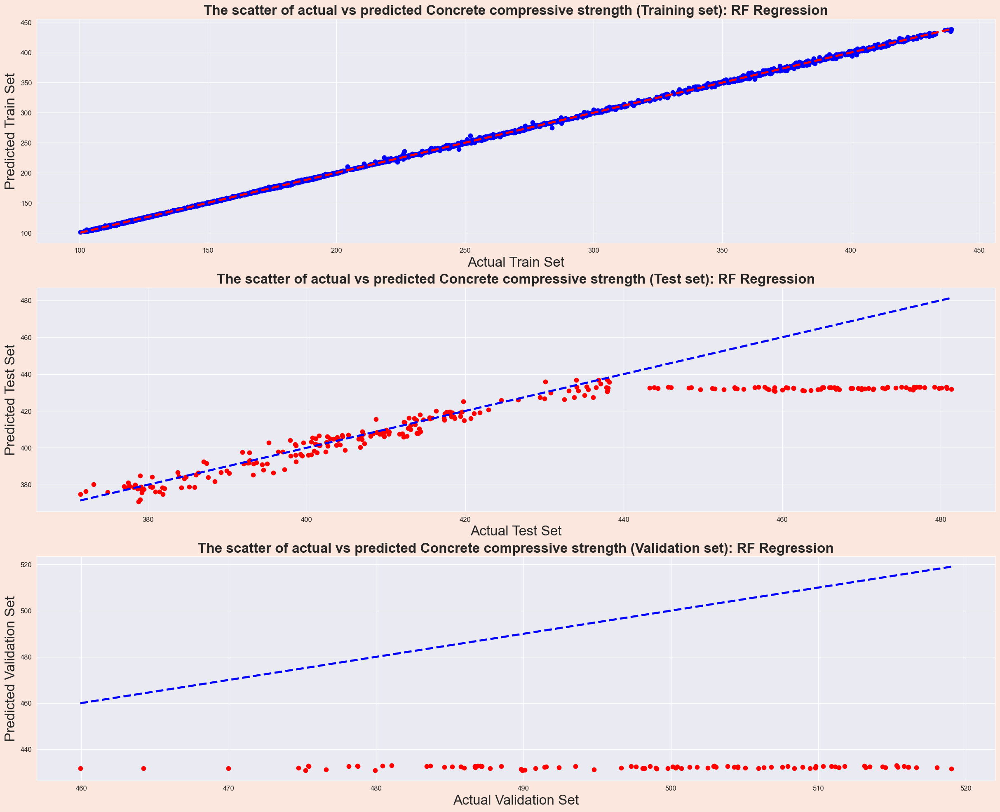

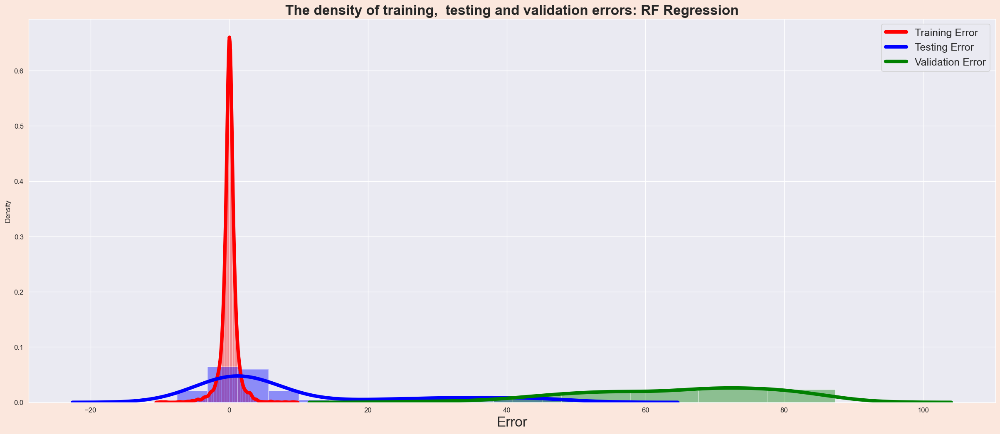

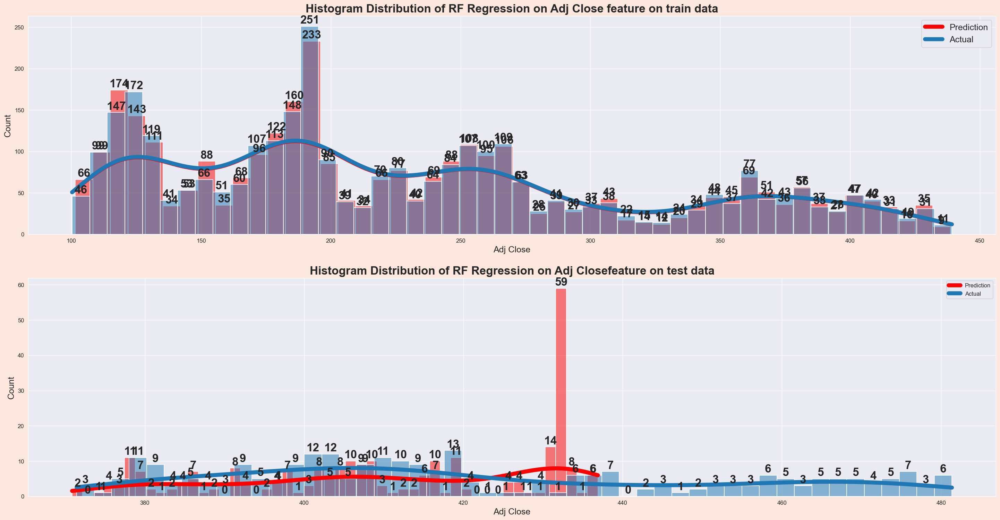

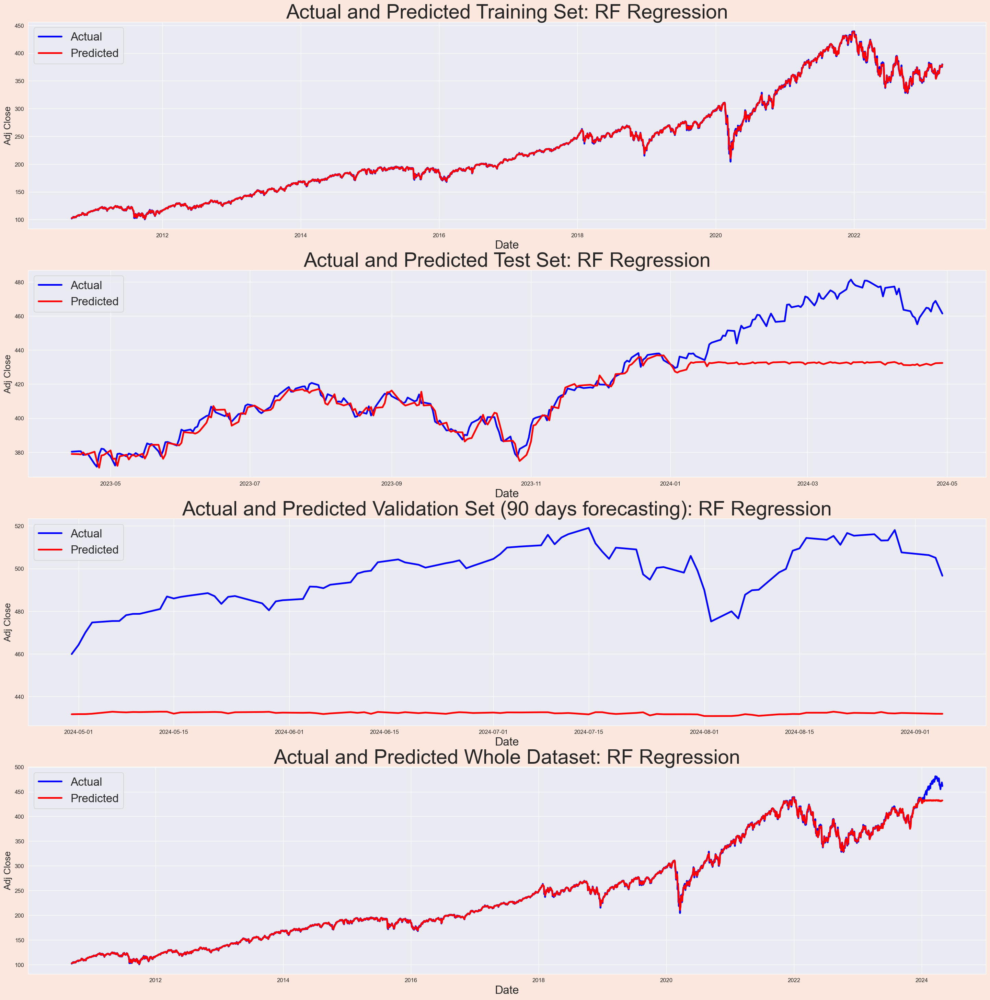

In [68]:
# Random Forest Regression
rf_reg = RandomForestRegressor()
perform_regression(rf_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, "RF Regression", "Adj Close")

next_day_price = predict_next_day_return(rf_reg, X_final, last_price)

### Decision Tree Regression 

RMSE using DT Regression: 21.099200765789604
mean square error:  445.1762729550966
variance or r-squared:  0.6801784417682178
ACTUAL: Avg. Adj Close:229.82783360988077
ACTUAL: Median Adj Close:201.40789
PREDICTED: Avg. Adj Close:409.31588006106875
PREDICTED: MedianAdj Close:414.23999
('mean square error (whole dataset): ', 33.984901956362265)
variance or r-squared (whole dataset):  0.9967342150867701
Next day stock price will be: $427.10001


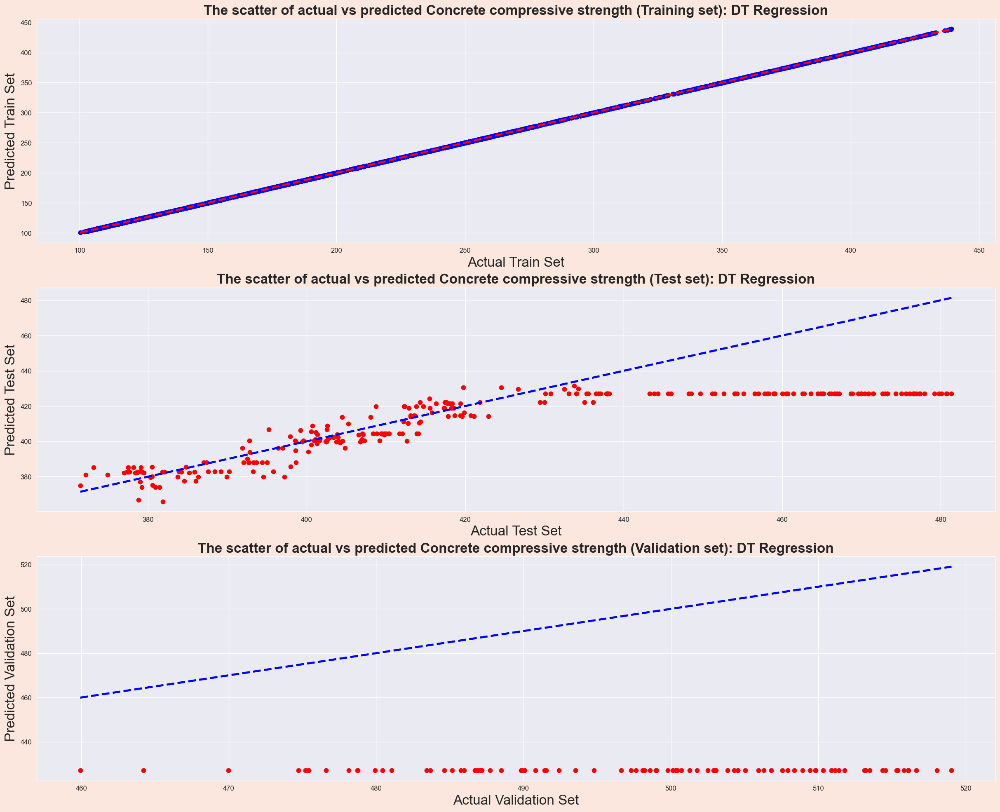

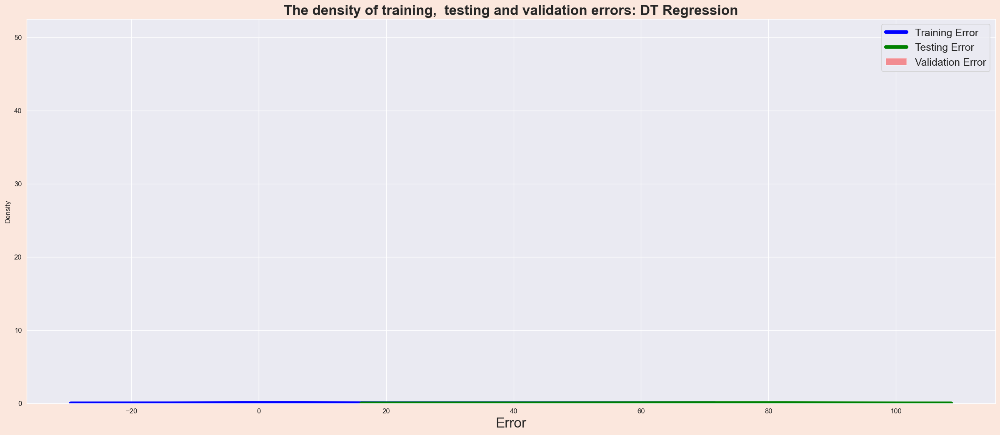

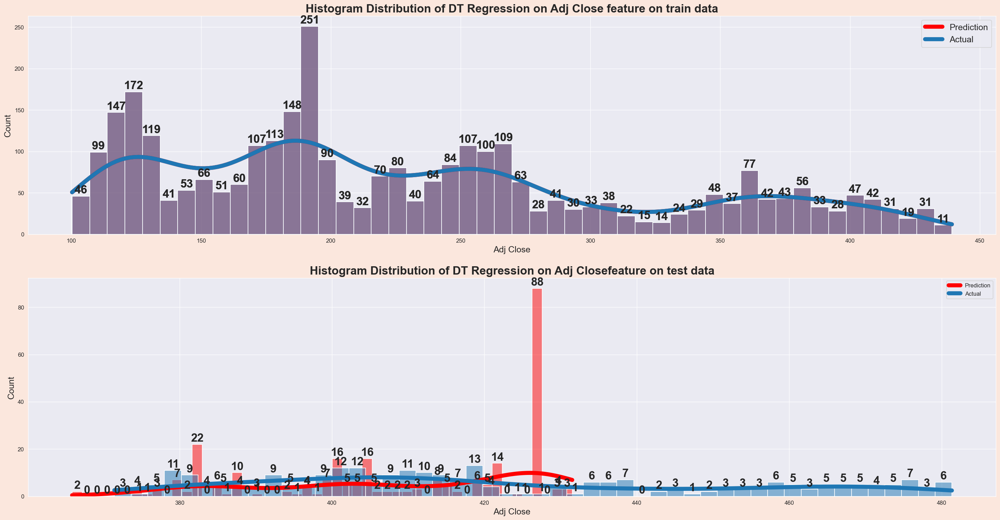

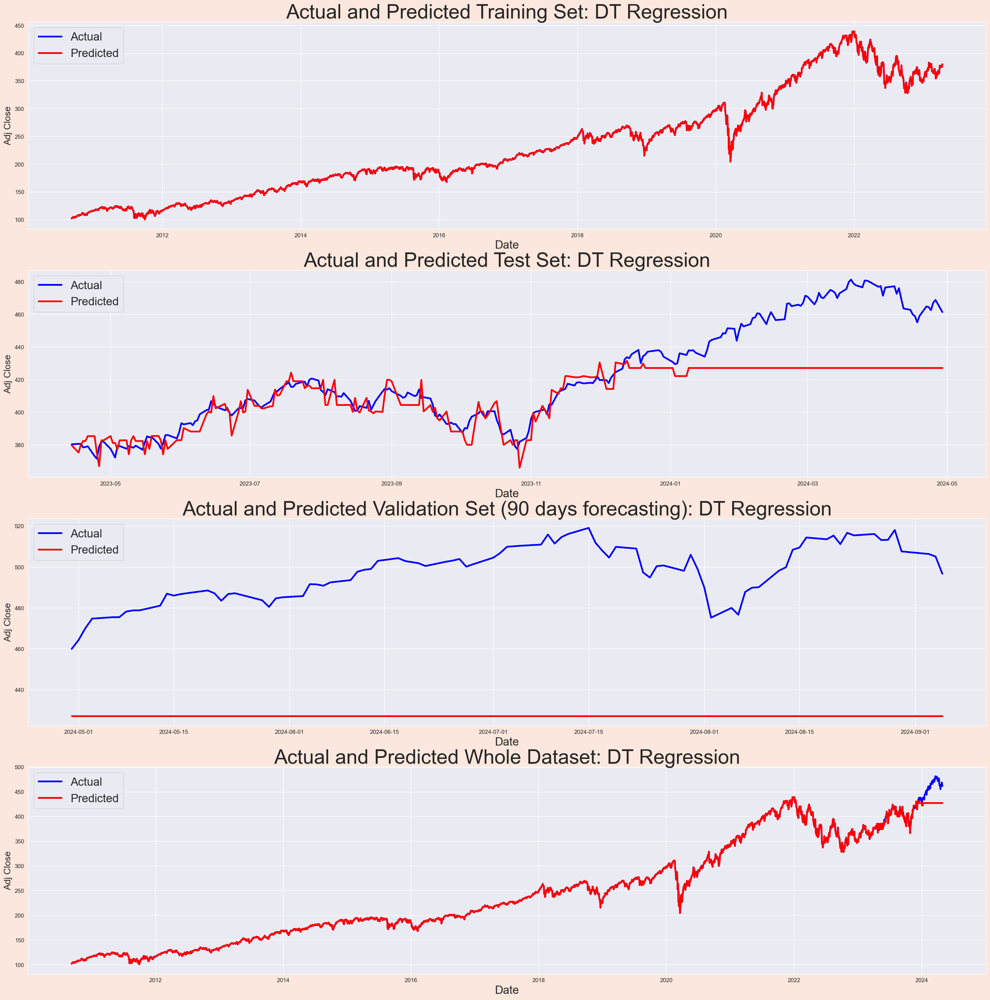

In [69]:
# Decision Tree (DT) regression
dt_reg = DecisionTreeRegressor(random_state=100)
perform_regression(dt_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, "DT Regression", "Adj Close")

next_day_price = predict_next_day_return(dt_reg, X_final, last_price)

### K-Nearest Neighbors Regression

RMSE using KNN Regression: 32.20983800762333
mean square error:  1037.4736644773366
variance or r-squared:  0.43536326400120573
ACTUAL: Avg. Adj Close:229.82783360988077
ACTUAL: Median Adj Close:201.40789
PREDICTED: Avg. Adj Close:398.8069454923664
PREDICTED: MedianAdj Close:398.11500050000006
('mean square error (whole dataset): ', 90.61464315611218)
variance or r-squared (whole dataset):  0.991327032064773
Next day stock price will be: $410.79666


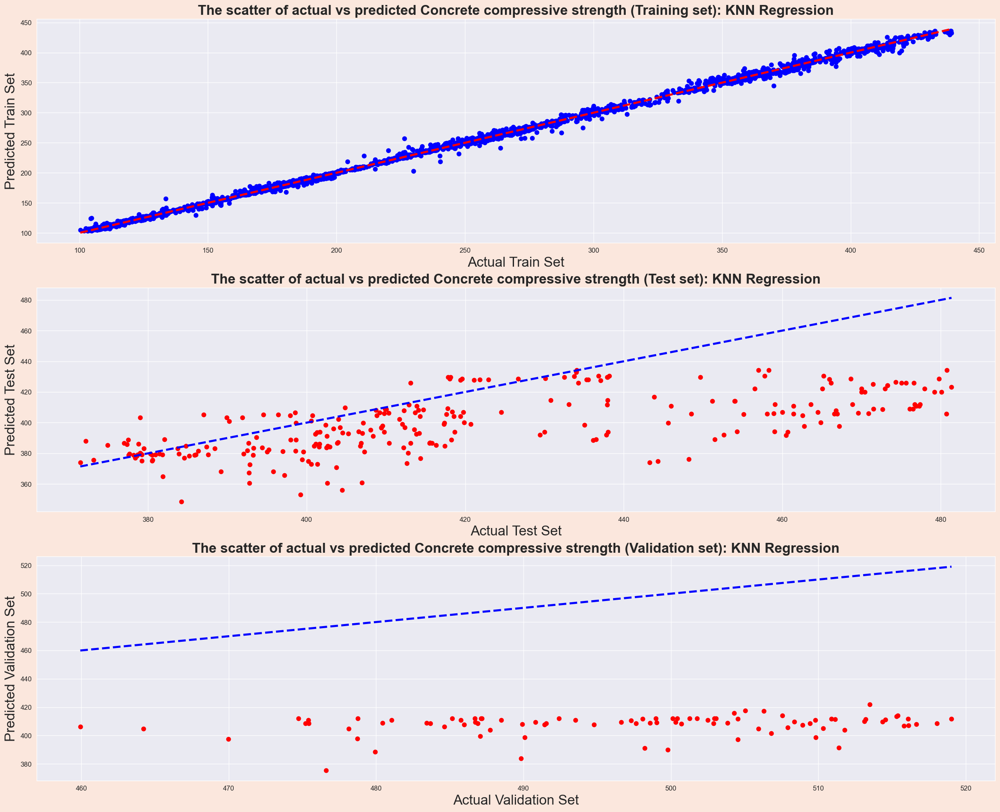

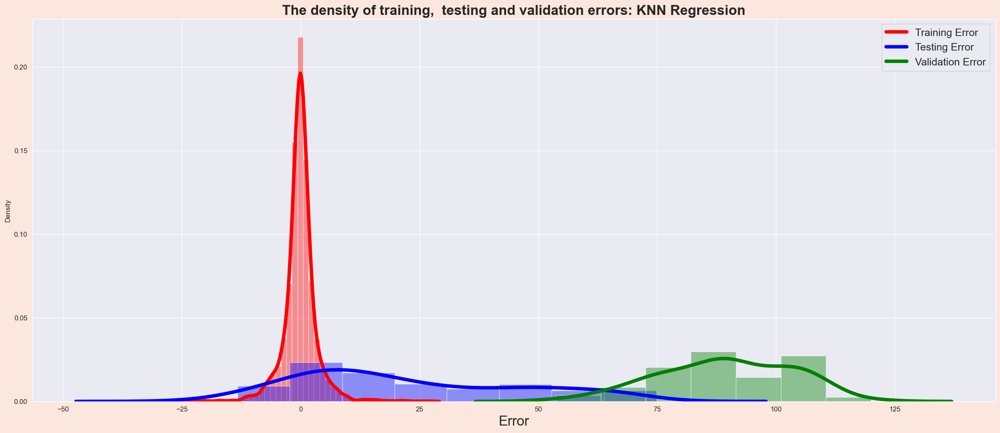

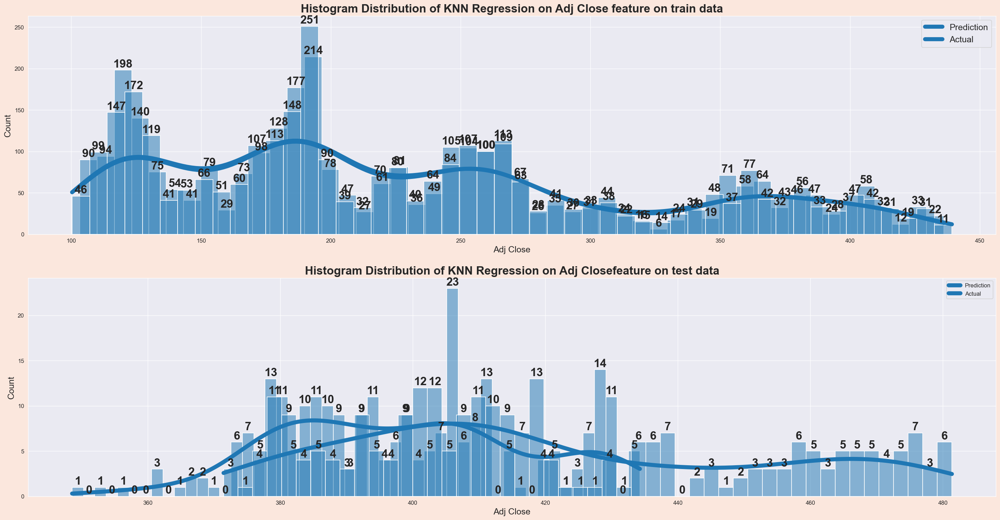

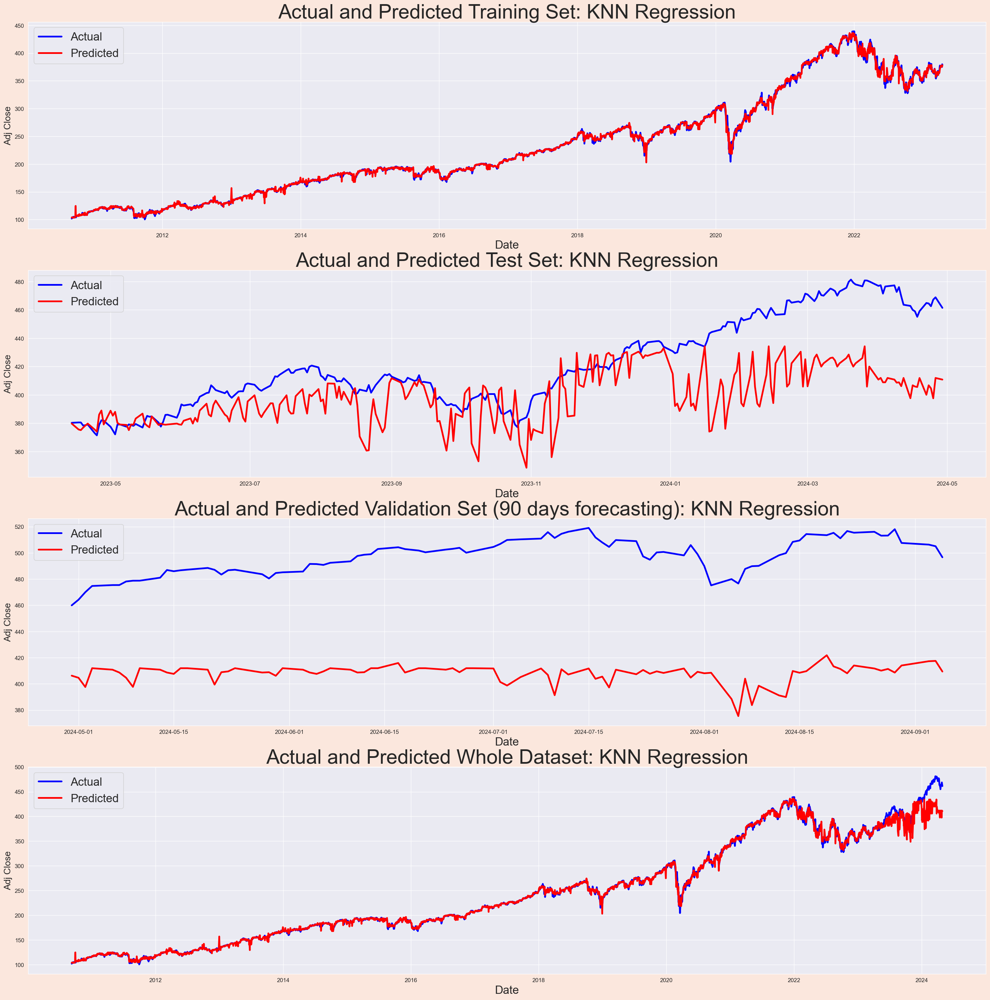

In [70]:
# KNN regression
knn_reg = KNeighborsRegressor(n_neighbors=3)
perform_regression(knn_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, "KNN Regression", "Adj Close")

next_day_price = predict_next_day_return(knn_reg, X_final, last_price)

### Adaboost regression

RMSE using Adaboost Regression: 21.987666626425536
mean square error:  483.45748367482736
variance or r-squared:  0.6529867827026898
ACTUAL: Avg. Adj Close:229.82783360988077
ACTUAL: Median Adj Close:201.40789
PREDICTED: Avg. Adj Close:408.811396671426
PREDICTED: MedianAdj Close:411.17862998730965
('mean square error (whole dataset): ', 55.91100394419127)
variance or r-squared (whole dataset):  0.9947967494425954
Next day stock price will be: $424.78594


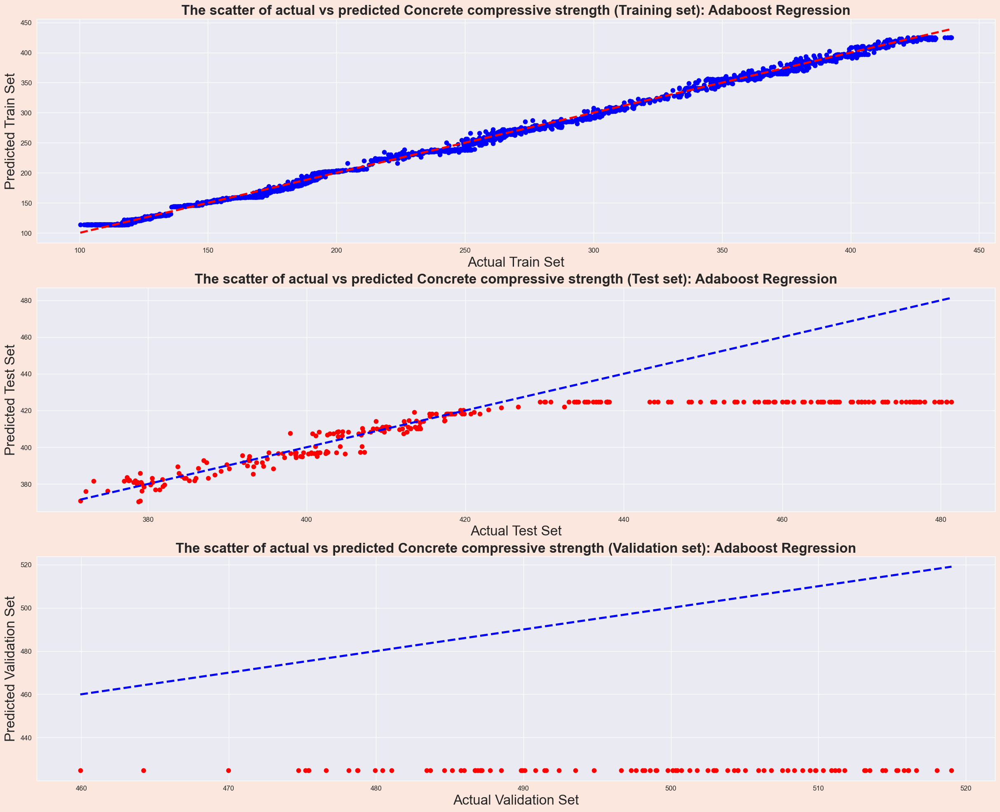

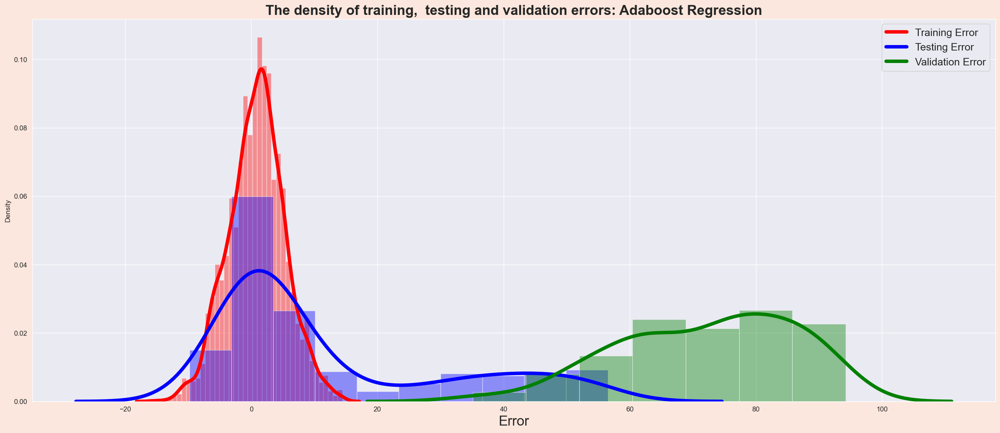

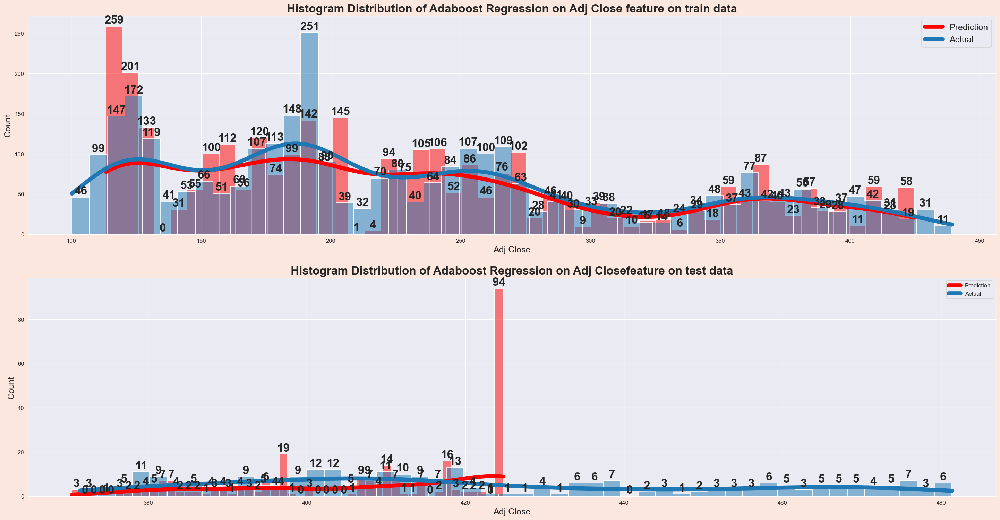

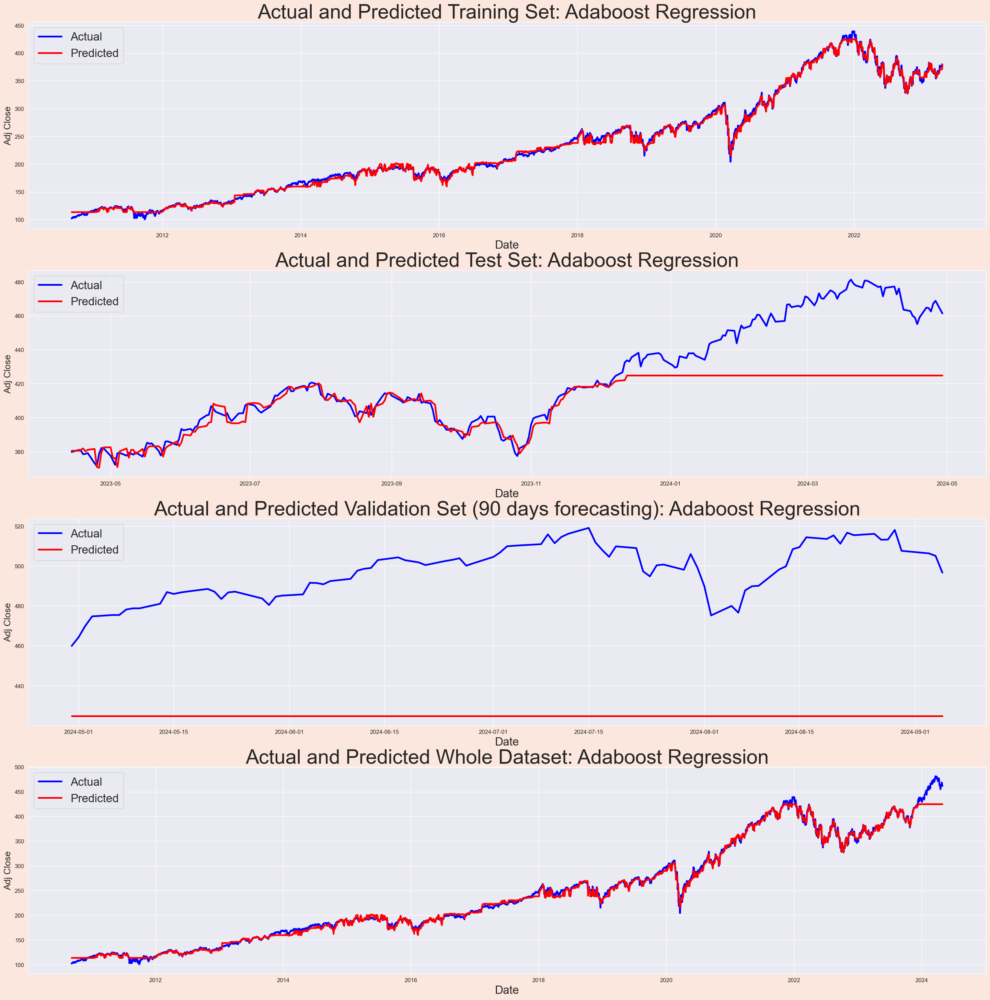

In [71]:
# Adaboost regression
ada_reg = AdaBoostRegressor(random_state=100, n_estimators=200)
perform_regression(ada_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, "Adaboost Regression", "Adj Close")

next_day_price = predict_next_day_return(ada_reg, X_final, last_price)

### Gradient Boosting Regression


RMSE using GB Regression: 18.87694513068657
mean square error:  356.3390574669514
variance or r-squared:  0.7358353527178487
ACTUAL: Avg. Adj Close:229.82783360988077
ACTUAL: Median Adj Close:201.40789
PREDICTED: Avg. Adj Close:410.9306627631566
PREDICTED: MedianAdj Close:410.9267704818897
('mean square error (whole dataset): ', 31.447005984943242)
variance or r-squared (whole dataset):  0.9969637928058134
Next day stock price will be: $429.91712


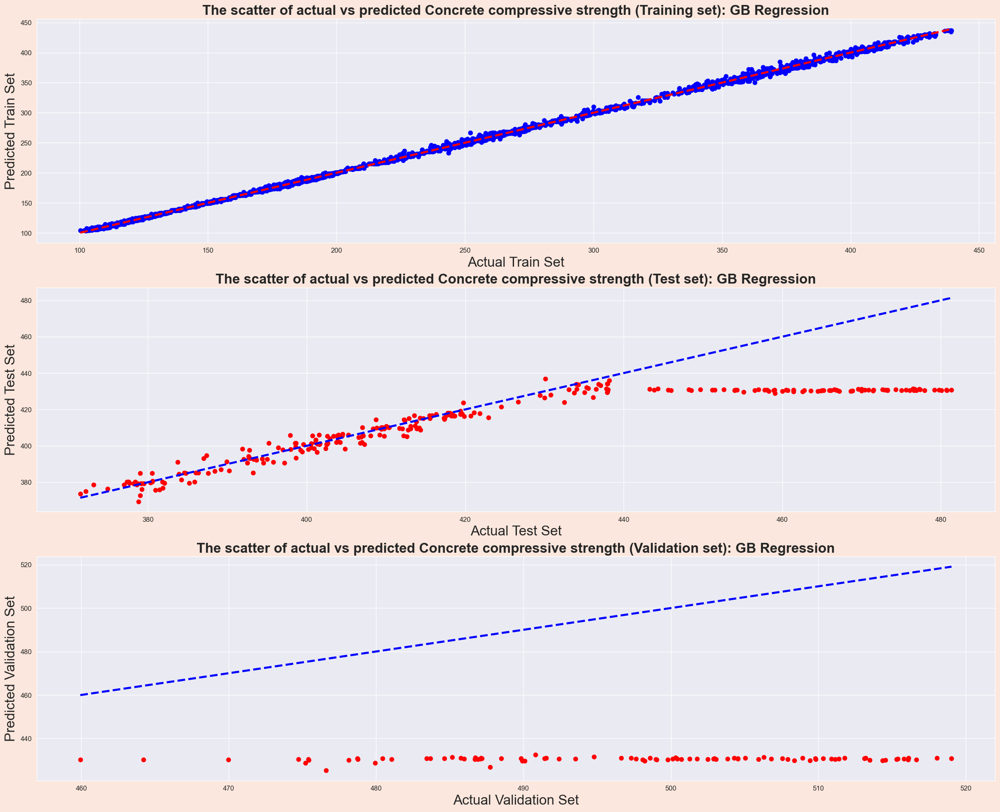

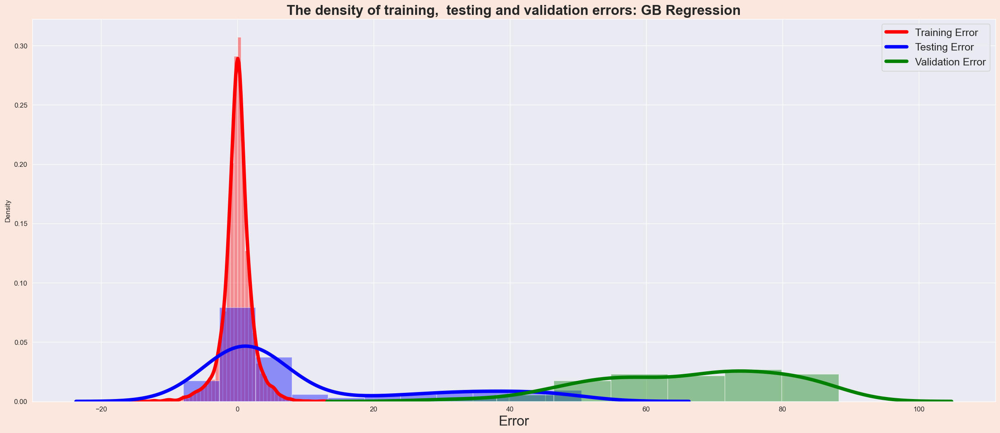

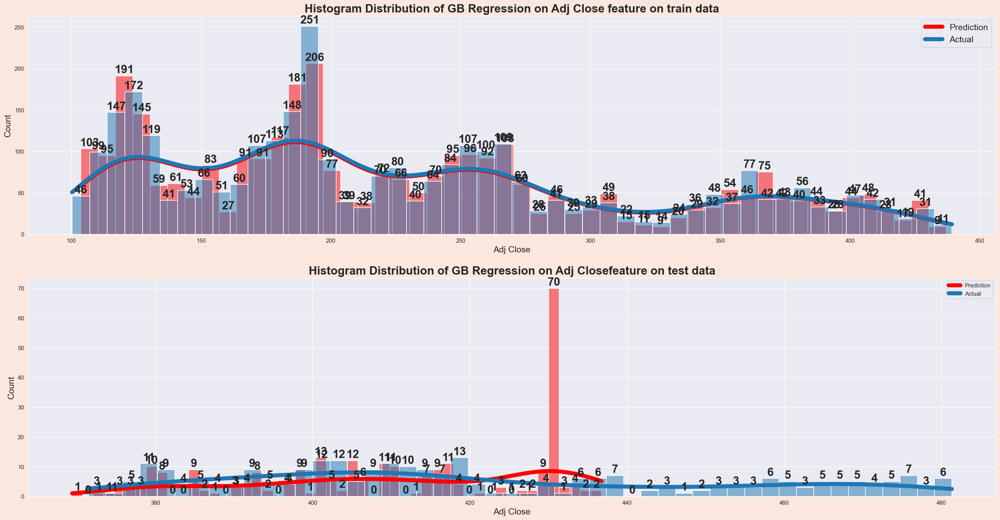

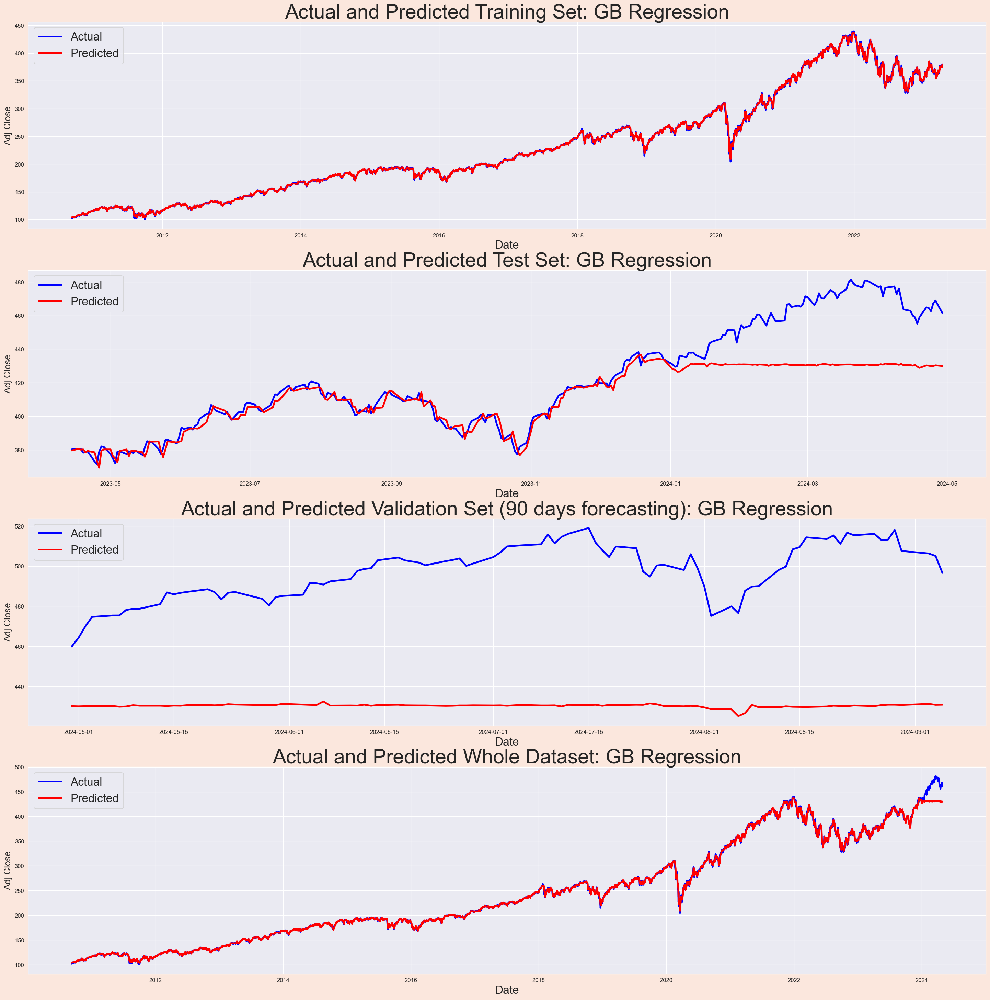

In [72]:
#Gradient Boosting regression
gb_reg = GradientBoostingRegressor(random_state=100)
perform_regression(gb_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, "GB Regression", "Adj Close")

next_day_price = predict_next_day_return(gb_reg, X_final, last_price)

### Extreme Gradient Boosting regression

RMSE using XGB Regression: 18.995487425551477
mean square error:  360.8285425342843
variance or r-squared:  0.732133920891371
ACTUAL: Avg. Adj Close:229.82783360988077
ACTUAL: Median Adj Close:201.40789
PREDICTED: Avg. Adj Close:410.88519287109375
PREDICTED: MedianAdj Close:410.98583984375
('mean square error (whole dataset): ', 33.60384796683229)
variance or r-squared (whole dataset):  0.9967522318921982
Next day stock price will be: $430.40424


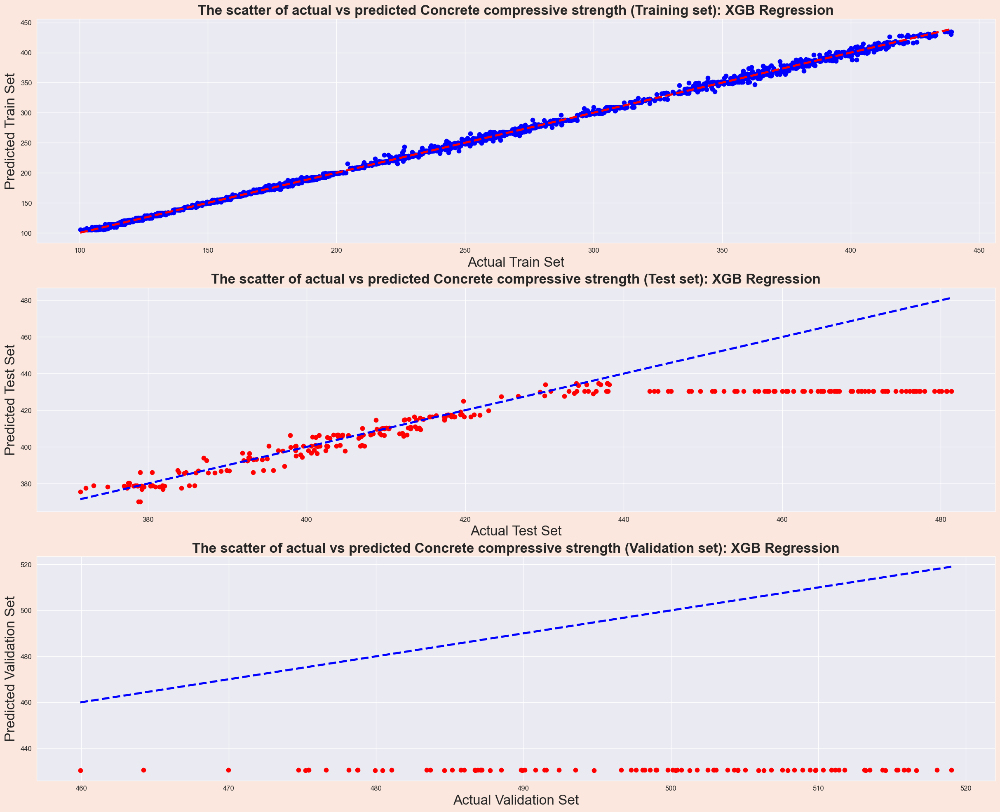

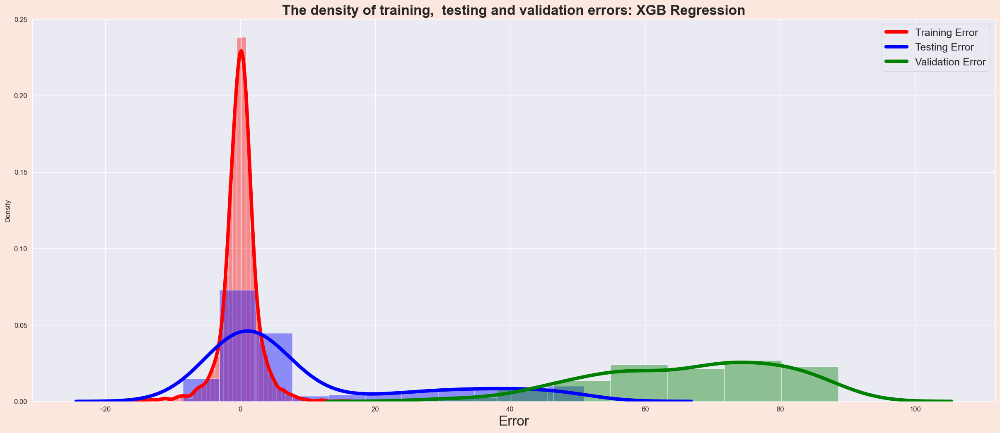

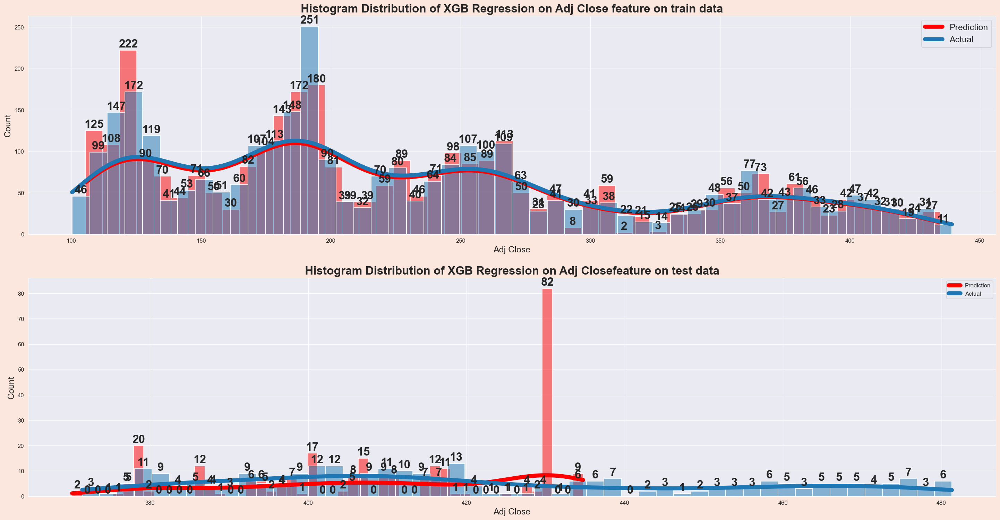

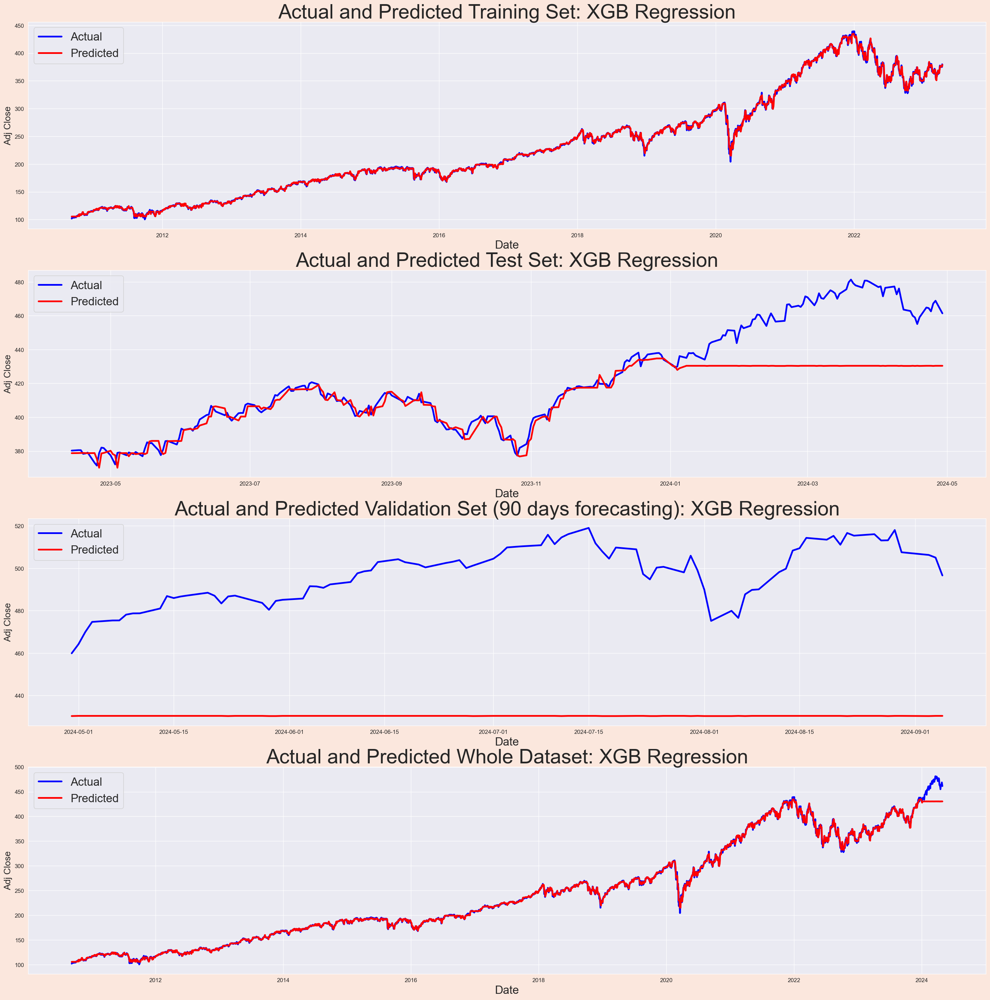

In [73]:
# Extreme Gradient Boosting (XGB)
xgb_reg = XGBRFRegressor(random_state=100)
perform_regression(xgb_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, "XGB Regression", "Adj Close")

next_day_price = predict_next_day_return(xgb_reg, X_final, last_price)

### Light Gradient Boosting Regression

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000934 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3913
[LightGBM] [Info] Number of data points in the train set: 3170, number of used features: 20
[LightGBM] [Info] Start training from score 230.044662
RMSE using LGBM Regression: 18.623980920135118
mean square error:  346.8526653135569
variance or r-squared:  0.7291383478865978
ACTUAL: Avg. Adj Close:229.82783360988077
ACTUAL: Median Adj Close:201.40789
PREDICTED: Avg. Adj Close:411.7559675230621
PREDICTED: MedianAdj Close:412.9494562246356
('mean square error (whole dataset): ', 28.601726668381534)
variance or r-squared (whole dataset):  0.9972346250227286
Next day stock price will be: $430.90450


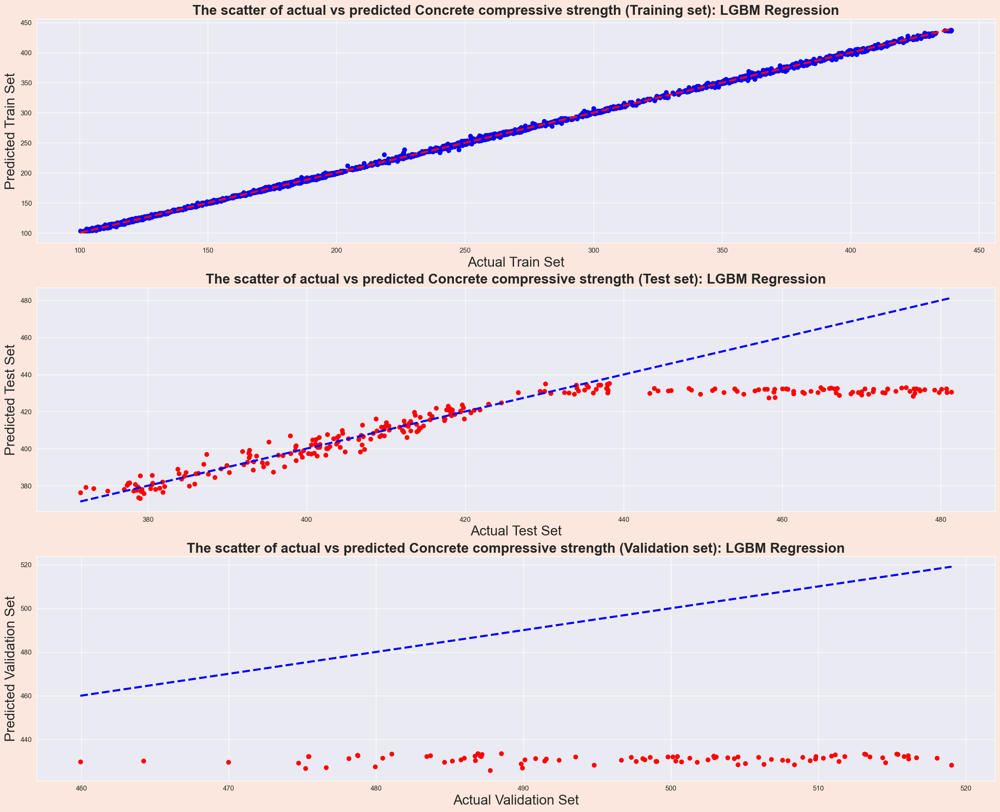

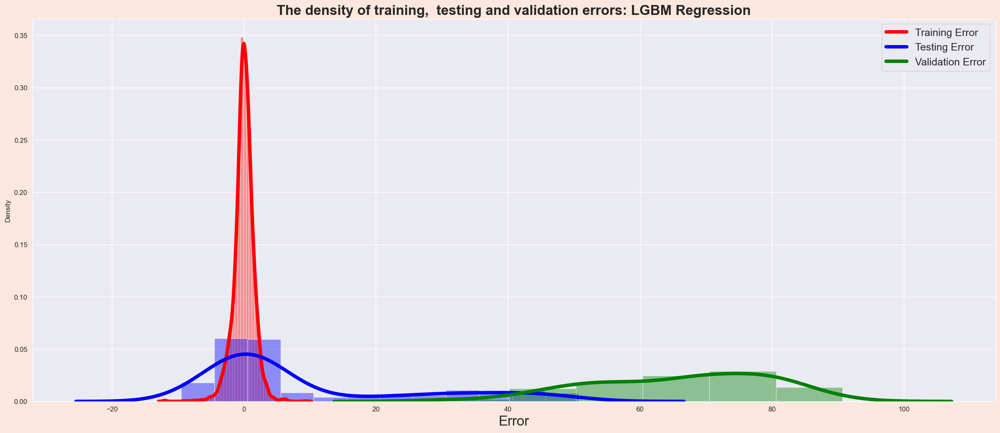

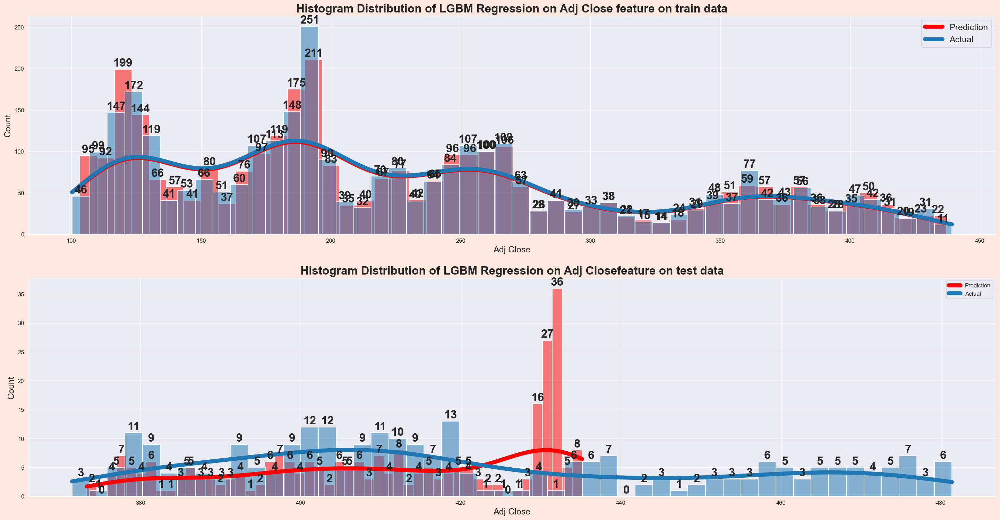

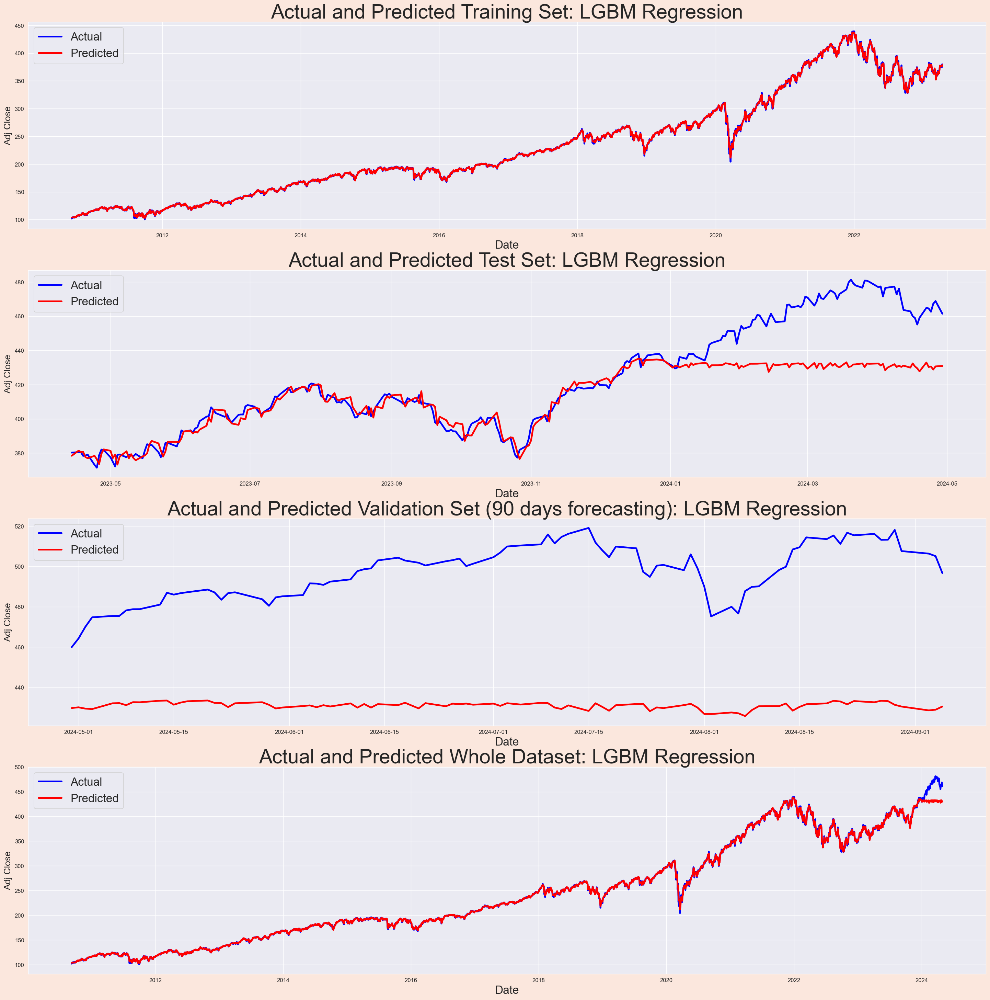

In [74]:
#Light Gradient Boosting Machine(LGBM)
lgbm_reg = LGBMRegressor(random_state=100)
perform_regression(lgbm_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, "LGBM Regression", "Adj Close")

next_day_price = predict_next_day_return(lgbm_reg, X_final, last_price)

### Catboost Regression

Learning rate set to 0.04913
0:	learn: 86.0659031	total: 61.6ms	remaining: 1m 1s
1:	learn: 82.0761513	total: 62.8ms	remaining: 31.4s
2:	learn: 78.3443064	total: 63.9ms	remaining: 21.2s
3:	learn: 74.7916063	total: 65ms	remaining: 16.2s
4:	learn: 71.2996350	total: 66.1ms	remaining: 13.2s
5:	learn: 67.9663867	total: 67.3ms	remaining: 11.1s
6:	learn: 64.8674729	total: 68.4ms	remaining: 9.71s
7:	learn: 61.9154260	total: 69.5ms	remaining: 8.62s
8:	learn: 59.1101915	total: 70.8ms	remaining: 7.79s
9:	learn: 56.3783198	total: 71.8ms	remaining: 7.11s
10:	learn: 53.7624862	total: 73.1ms	remaining: 6.57s
11:	learn: 51.2905152	total: 74.3ms	remaining: 6.11s
12:	learn: 48.9353793	total: 75.3ms	remaining: 5.72s
13:	learn: 46.6630792	total: 76.5ms	remaining: 5.39s
14:	learn: 44.5151420	total: 77.6ms	remaining: 5.09s
15:	learn: 42.5156567	total: 78.6ms	remaining: 4.83s
16:	learn: 40.5569120	total: 79.9ms	remaining: 4.62s
17:	learn: 38.7007441	total: 81ms	remaining: 4.42s
18:	learn: 36.9543487	total: 82

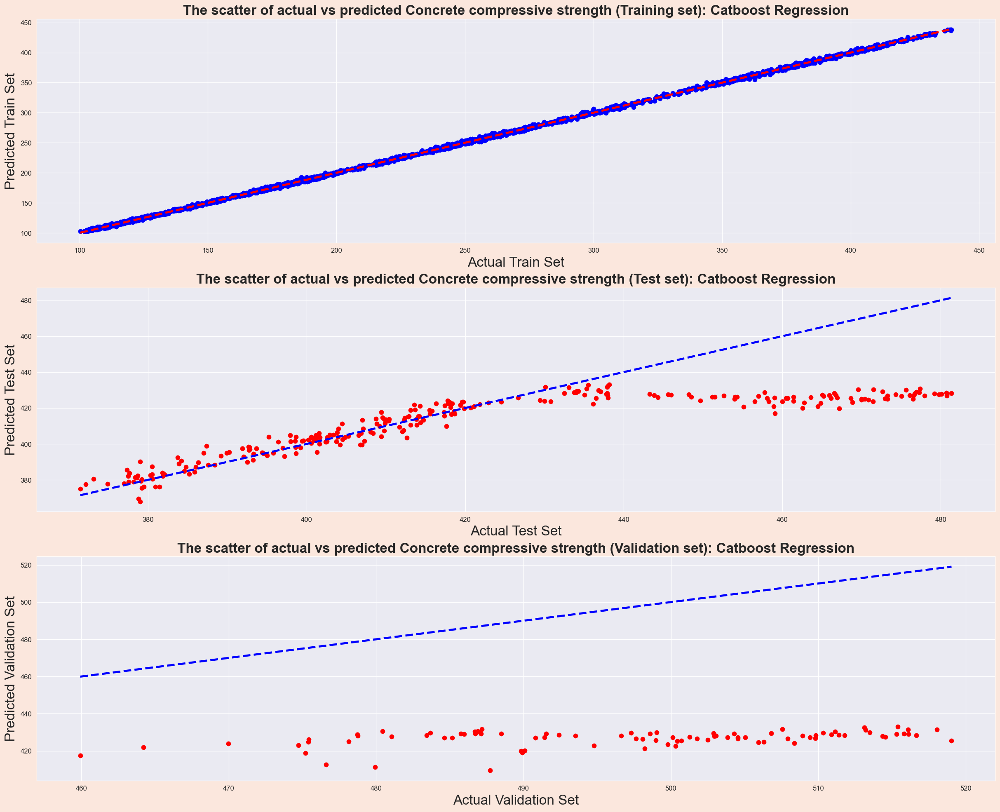

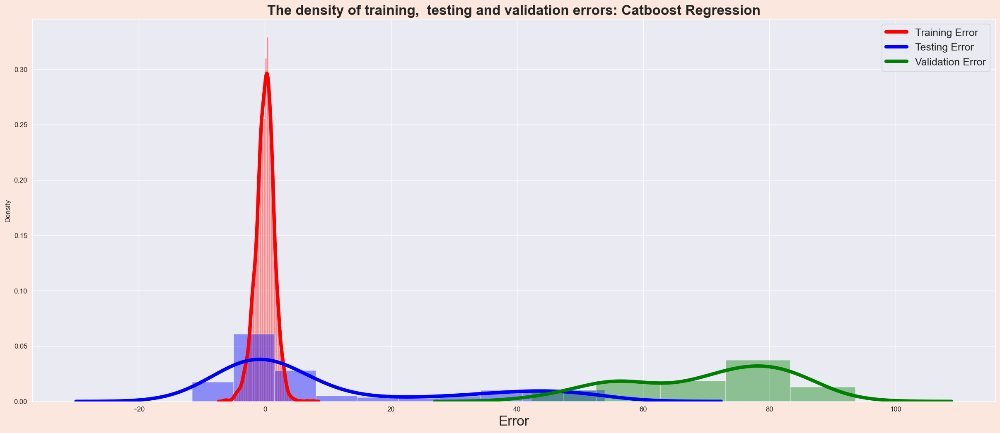

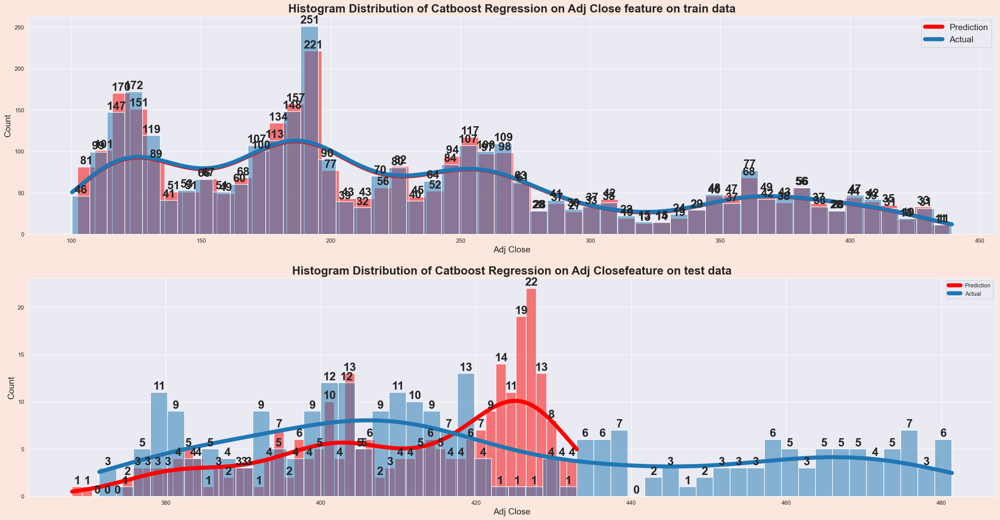

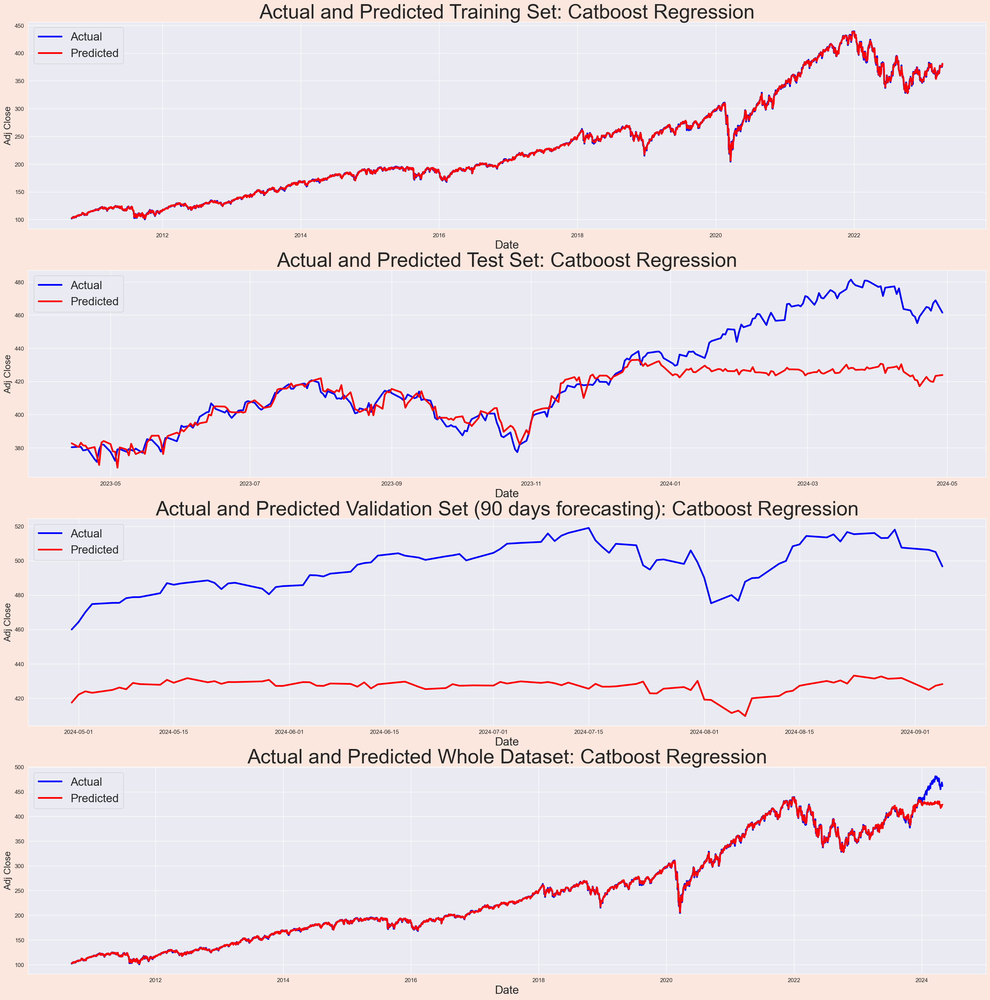

In [75]:
#Catboost regression
cb_reg = CatBoostRegressor(random_state=100)
perform_regression(cb_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, "Catboost Regression", "Adj Close")

next_day_price = predict_next_day_return(cb_reg, X_final, last_price)

### Support Vector Regression 


RMSE using SVR Regression: 60.03423816315507
mean square error:  3604.109751830424
variance or r-squared:  -0.39586683728406635
ACTUAL: Avg. Adj Close:229.82783360988077
ACTUAL: Median Adj Close:201.40789
PREDICTED: Avg. Adj Close:373.49209012299895
PREDICTED: MedianAdj Close:373.12827292577725
('mean square error (whole dataset): ', 448.84676263097725)
variance or r-squared (whole dataset):  0.957588931718656
Next day stock price will be: $372.06783


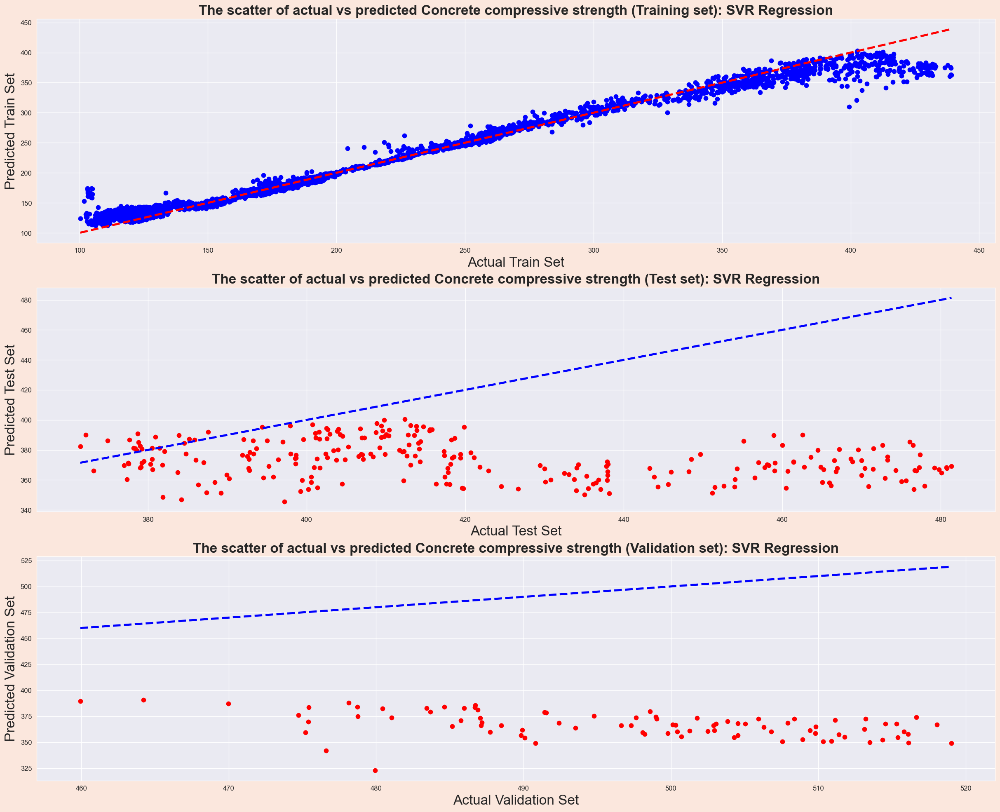

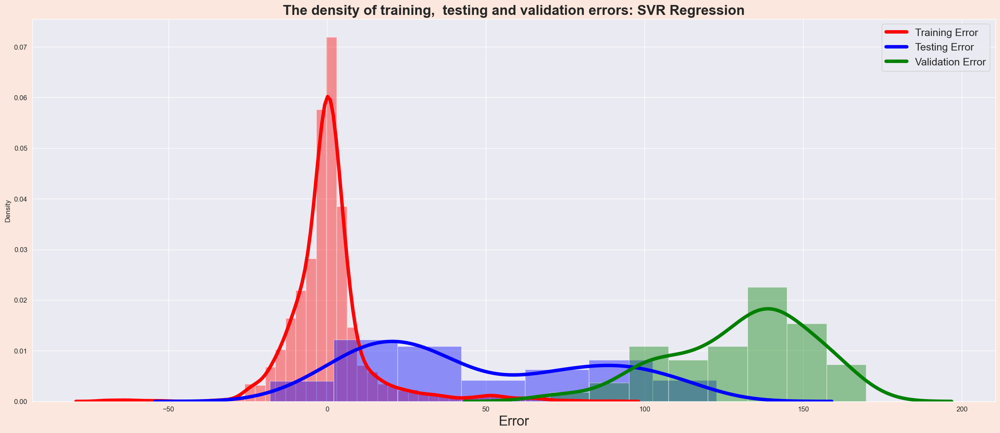

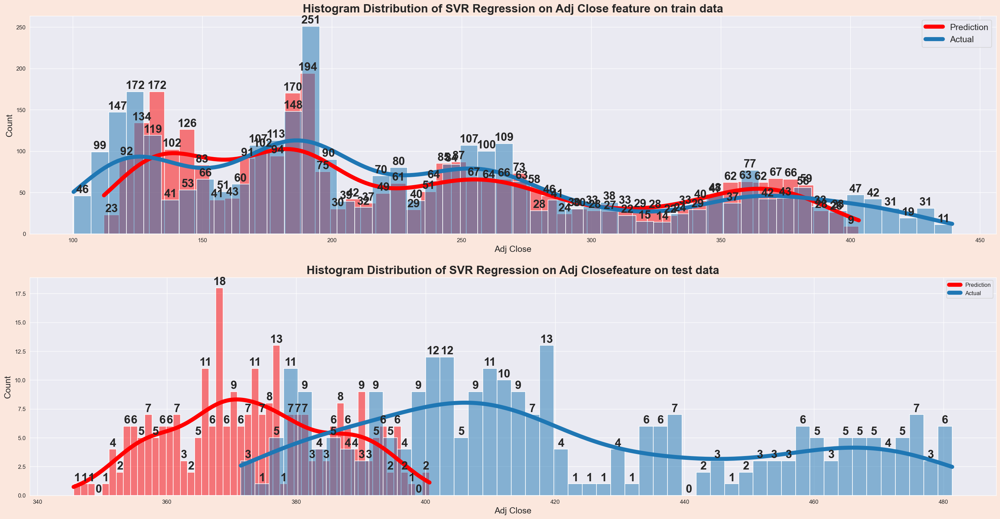

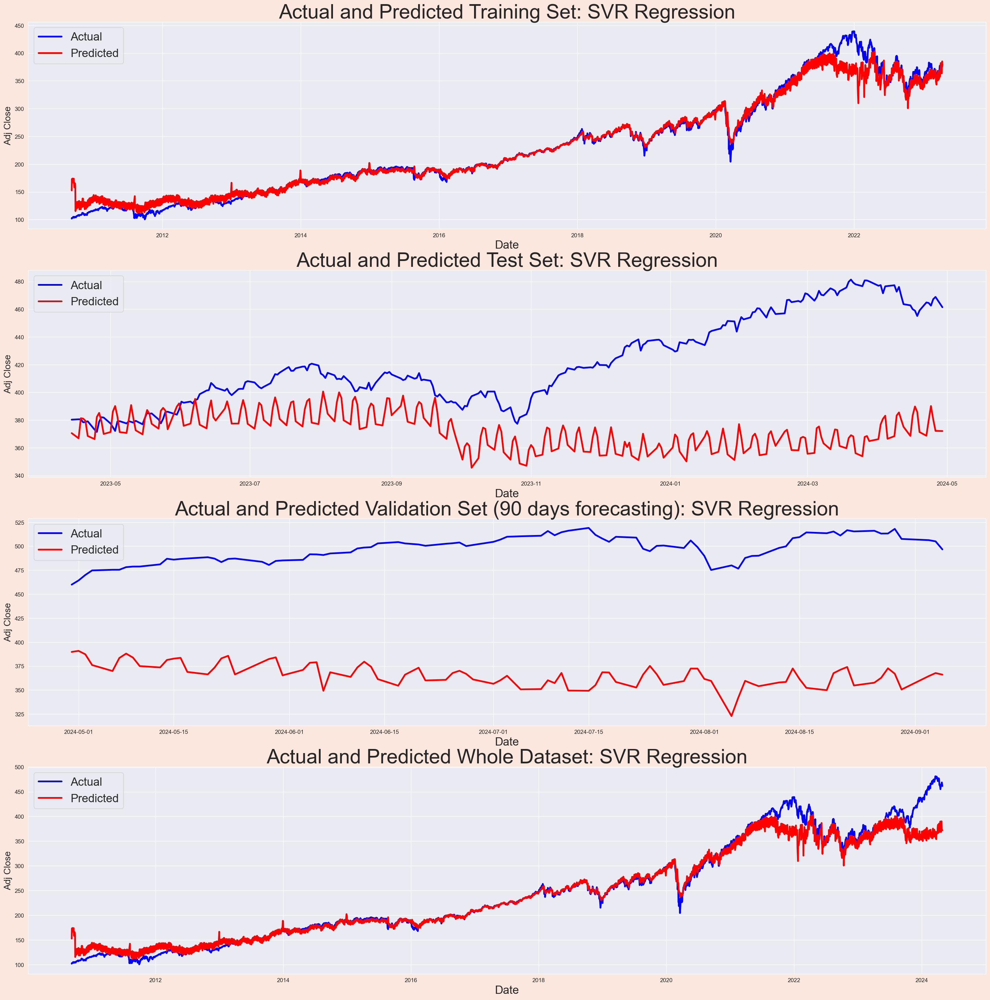

In [76]:
#SVR regression
svm_reg = SVR()
perform_regression(svm_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, "SVR Regression", "Adj Close")

next_day_price = predict_next_day_return(svm_reg, X_final, last_price)

### Multi-Layer Perceptron Regression

RMSE using MLP Regression: 3.2468034029025015
mean square error:  10.541732337099264
variance or r-squared:  0.989309136330029
ACTUAL: Avg. Adj Close:229.82783360988077
ACTUAL: Median Adj Close:201.40789
PREDICTED: Avg. Adj Close:421.4820340099134
PREDICTED: MedianAdj Close:414.3344723910099
('mean square error (whole dataset): ', 8.443898325365573)
variance or r-squared (whole dataset):  0.9991693010492304
Next day stock price will be: $467.93715


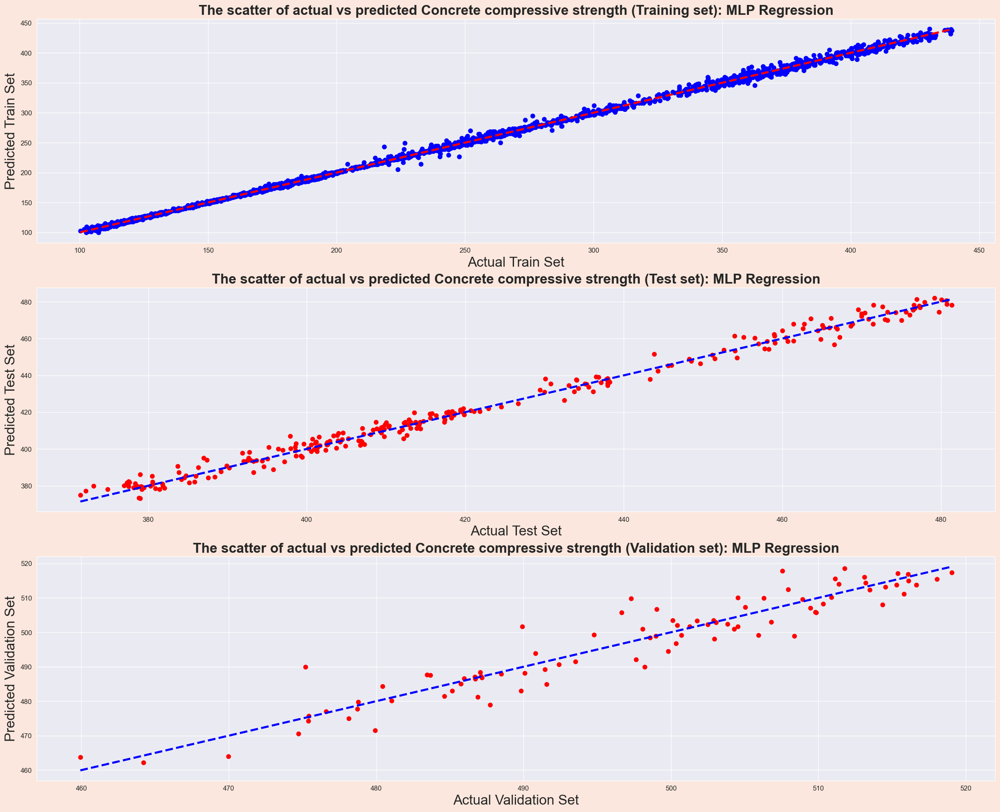

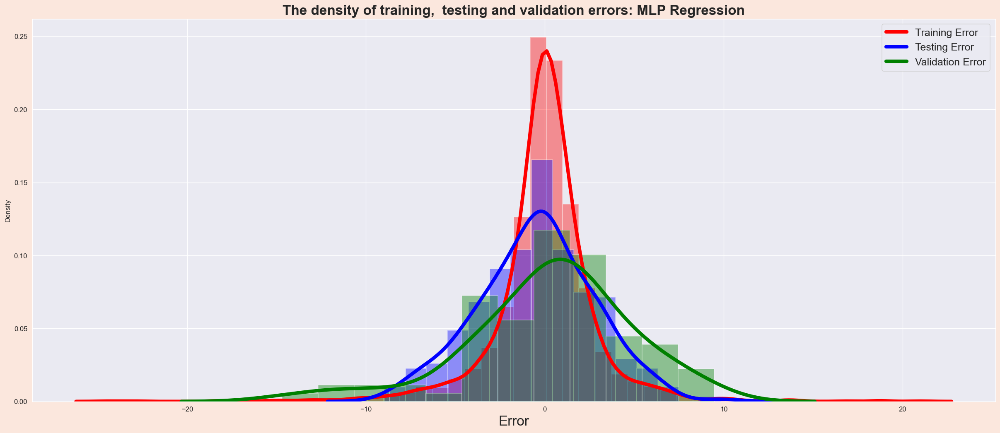

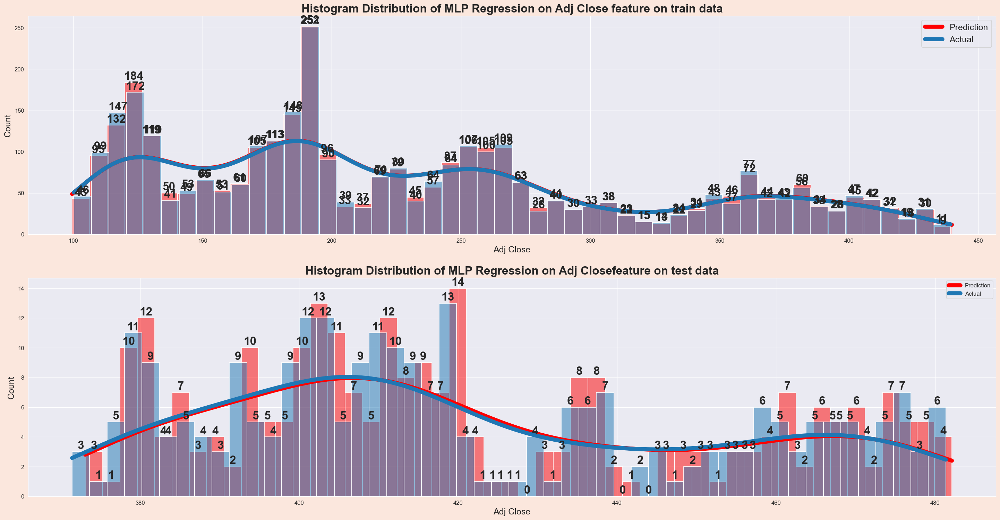

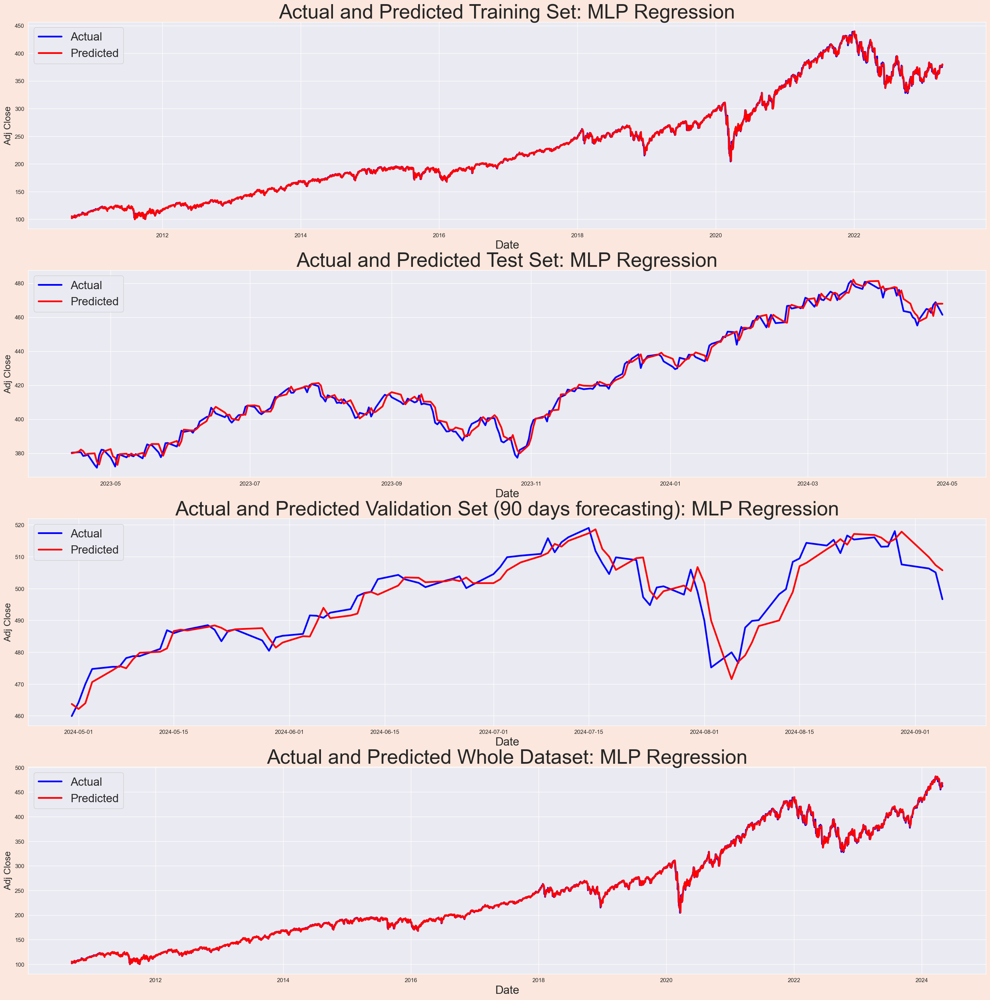

In [77]:
mlp_reg = MLPRegressor(random_state=100, max_iter=1000)
perform_regression(mlp_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, "MLP Regression", "Adj Close")

next_day_price = predict_next_day_return(mlp_reg, X_final, last_price)

### Lasso Regression

RMSE using Lasso Regression: 3.3134749450862397
mean square error:  10.97911621171426
variance or r-squared:  0.9889604903926978
ACTUAL: Avg. Adj Close:229.82783360988077
ACTUAL: Median Adj Close:201.40789
PREDICTED: Avg. Adj Close:421.5781902086688
PREDICTED: MedianAdj Close:414.1392551295868
('mean square error (whole dataset): ', 8.593743666850353)
variance or r-squared (whole dataset):  0.9991545583582724
Next day stock price will be: $469.25371


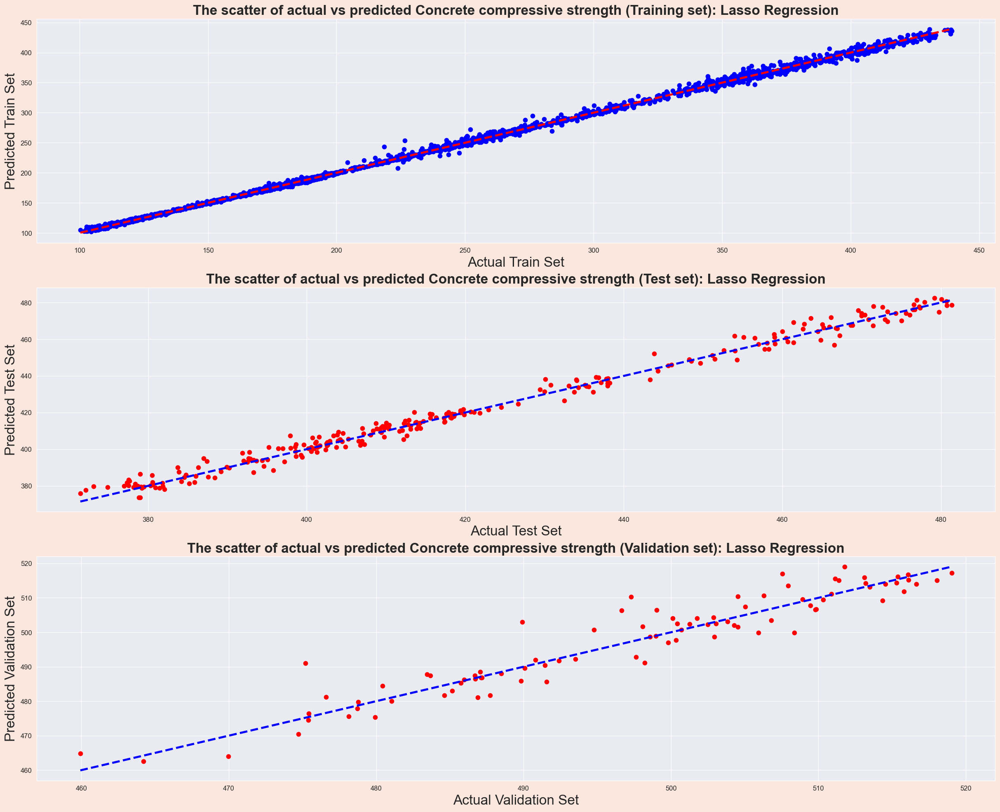

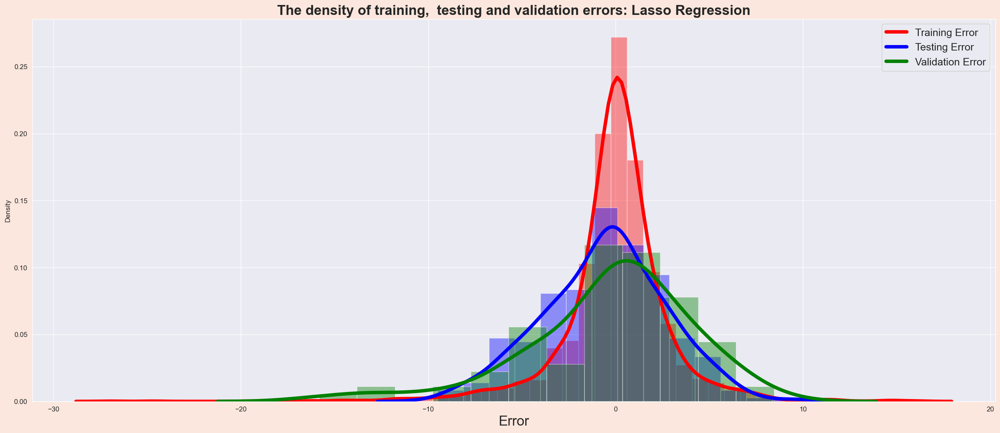

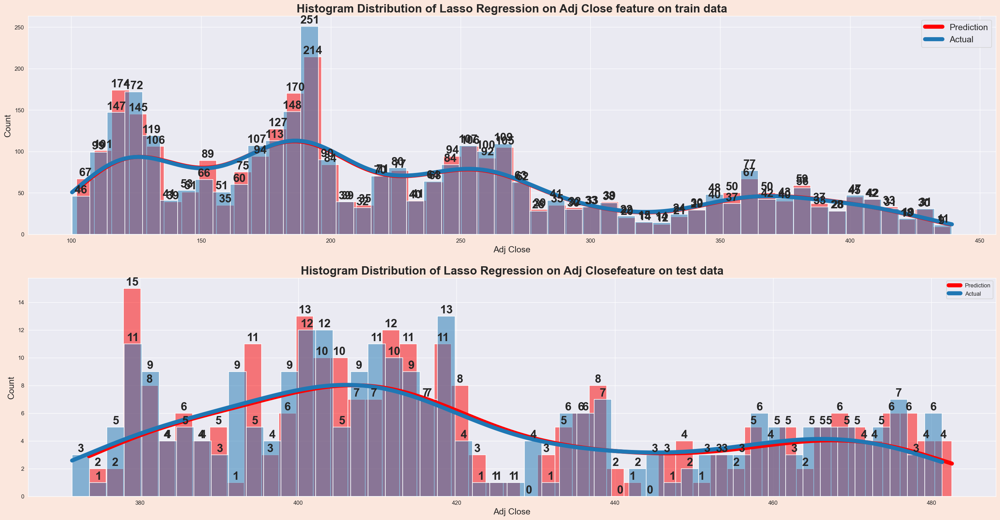

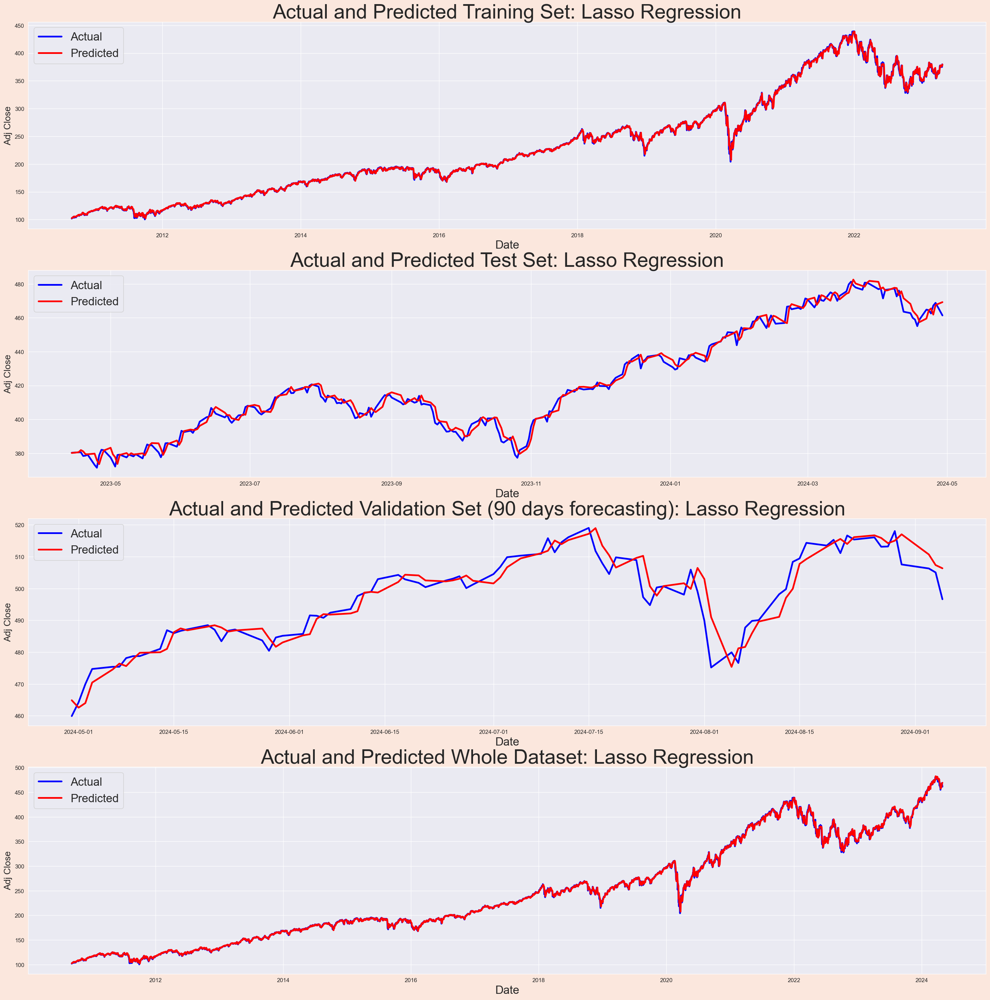

In [78]:
# Lasso regression
lasso_reg = LassoCV(n_alphas=1000, max_iter=3000, random_state=0)
perform_regression(lasso_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, "Lasso Regression", "Adj Close")

next_day_price = predict_next_day_return(lasso_reg, X_final, last_price)

### Ridge Regression

RMSE using Ridge Regression: 3.5246321624220376
mean square error:  12.423031880379847
variance or r-squared:  0.9891371549159602
ACTUAL: Avg. Adj Close:229.82783360988077
ACTUAL: Median Adj Close:201.40789
PREDICTED: Avg. Adj Close:422.3987442324698
PREDICTED: MedianAdj Close:414.5355329257869
('mean square error (whole dataset): ', 8.333549472065126)
variance or r-squared (whole dataset):  0.9991810874159606
Next day stock price will be: $470.59851


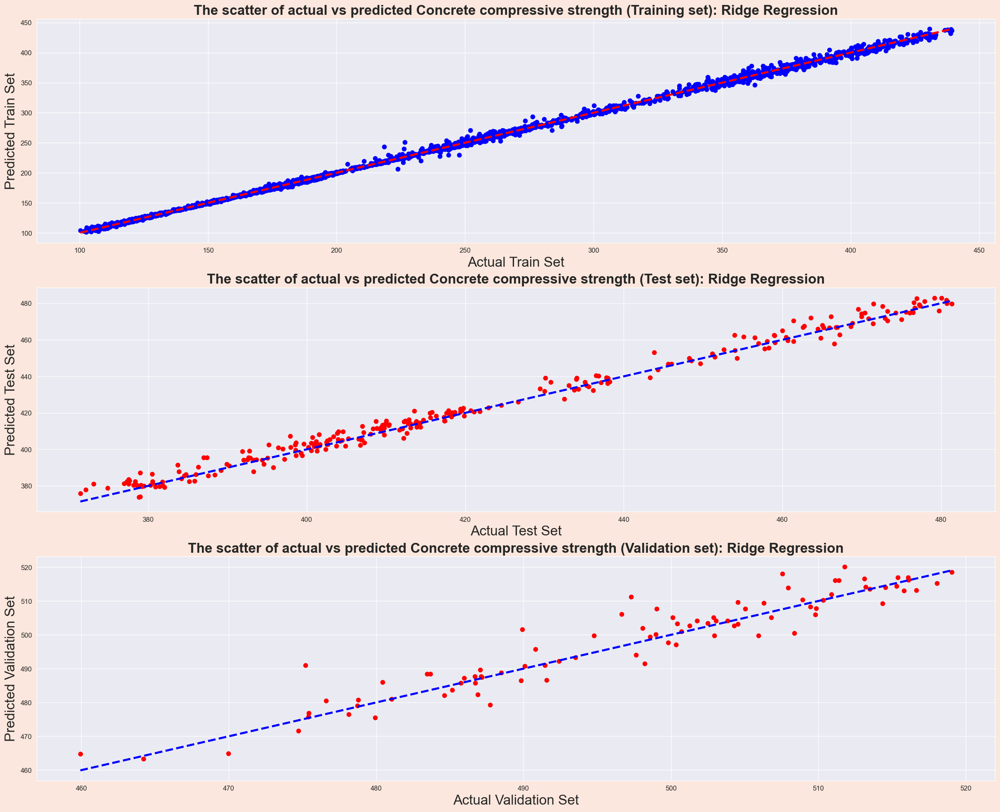

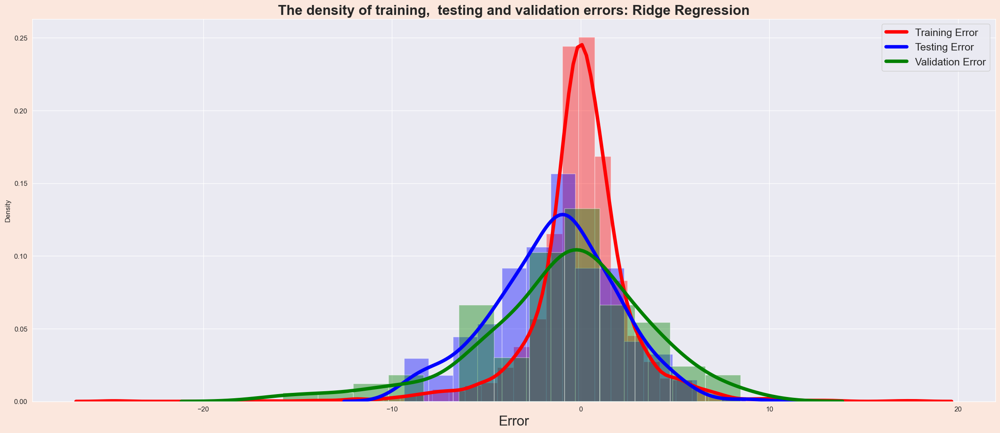

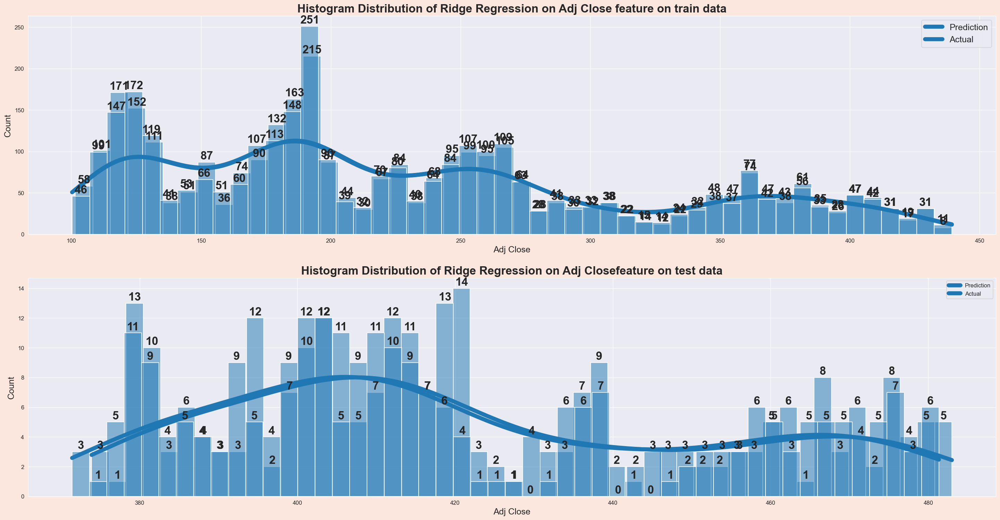

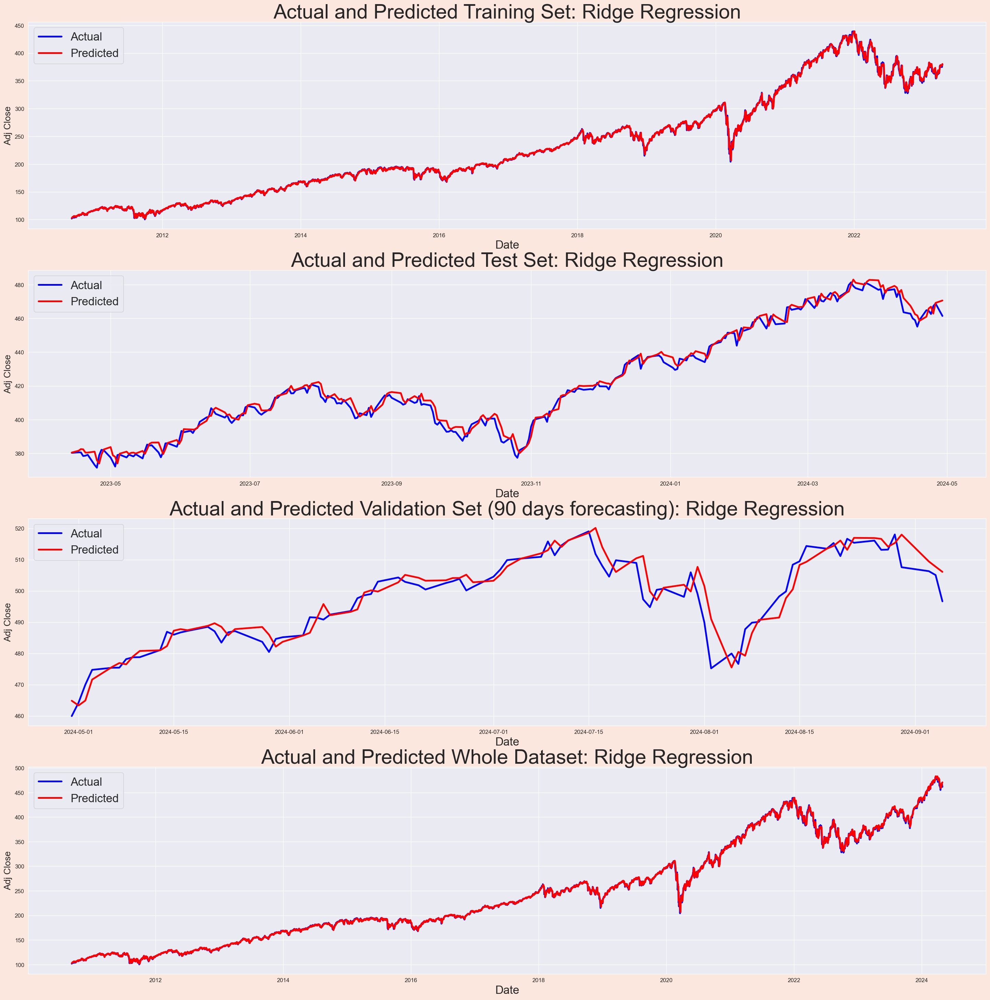

In [79]:
# Ridge regression
ridge_reg = RidgeCV(gcv_mode='auto')
perform_regression(ridge_reg, X_final, y_final, X_train, y_train, X_test, y_test, X_val, y_val, "Ridge Regression", "Adj Close")

next_day_price = predict_next_day_return(ridge_reg, X_final, last_price)